# How Do Danes Drive?

### The project idea
The main idea behind our project is summarized in this video

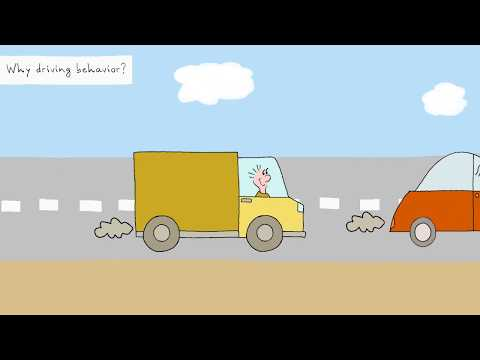

In [121]:
from IPython.display import YouTubeVideo
YouTubeVideo("LNPDZ1TbVPU",width=800,height=450)

In Denmark:
- there are 2.5 million cars, about one in every two people, and 42600 trucks
- commuters spend 146 hours per week driving to work
- traffic delays cost Denmark 20 billion DKK every year

Driving has a considerable impact on the lives of Danes and on the Danish cities. Furthemore, investigating the driving behavior of a population might shed light on its underlying traits and on geographical differences.
Therefore, we would like to explore the driving behavior of Danes, visualize geographic patterns and explain the variation among municipalities. 

To do so, we will use two different data sets:
- a [traffic data set](https://www.opendata.dk/vejdirektoratet/stojdata-mastra) - containing data about traffic measurements performed in several Danish roads
- a [socioeconomic data set](http://noegletal.dk/noegletal/) - containing data about socioeconomic indicators in Danish municipalities


###  Index

I. Exploring the driving behavior (traffic data set)
   1. Data loading and cleaning
   2. Data manipulation
   3. Summary statistics and variable distribution
   4. Data exploration
    
II. Explaining the driving behavior
  1. Addressing our research questions
  2. The socioeconomic data set
  


# I. Exploring the driving behavior (traffic data set)
## 1. Data loading and cleaning


### 1.A Importing packages and defining functions

##### Import packages

In [122]:
# Load the Pandas libraries with alias 'pd' 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from folium import plugins
from folium.plugins import HeatMap
import folium
from scipy import stats
import branca
from sklearn.neighbors import KNeighborsRegressor
import geopandas as gpd
from mpl_toolkits.axes_grid1 import make_axes_locatable
np.warnings.filterwarnings('ignore')
pd.set_option("display.max_columns", 30)

##### Define functions

In [123]:
import numpy as np

def pearsonr_ci(x,y,alpha=0.05):
    ''' calculate Pearson correlation along with the confidence interval using scipy and numpy
    Parameters
    ----------
    x, y : iterable object such as a list or np.array
      Input for correlation calculation
    alpha : float
      Significance level. 0.05 by default
    Returns
    -------
    r : float
      Pearson's correlation coefficient
    pval : float
      The corresponding p value
    lo, hi : float
      The lower and upper bound of confidence intervals
    '''

    r, p = stats.pearsonr(x,y)
    r_z = np.arctanh(r)
    se = 1/np.sqrt(x.size-3)
    z = stats.norm.ppf(1-alpha/2)
    lo_z, hi_z = r_z-z*se, r_z+z*se
    lo, hi = np.tanh((lo_z, hi_z))
    return r, p, lo, hi

### 1.B Loading data

We load the data and then we inspect the variables, to have an overview of the information contained in the data set.

In [124]:
url = 'https://raw.githubusercontent.com/IncioMan/socialdata/master/FinalProject/dataset/trafficdata_withlonlat_ver2.csv'
traffic_data = pd.read_csv(url, error_bad_lines=False)
traffic_data.Latitude = traffic_data.Latitude.str.replace(";", "")
traffic_data.head()

,FID,Dataowner,RoadManager,RoadId,RoadPartId,RoadName,Kilometer,Meter,Location,Municipality,TypeOfVehicle,Year,AverageDailyVehicles,AverageWeekdayDailyVehicles,DailyJulyTraffic,...,AverageSpeed,CountedDays,AE10High,AE10Low,AverageDailyTrucks,SpeedLimit,Quantile15,Quantile85,PctOverSpeedLimit,PctOverSpeedLimit10,PctOverSpeedLimit20,PctOfTrucks,Coordinates,Longitude,Latitude
0,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,751,751.0,7511252,0,Christian X´s Vej,0.0,540.0,Ml. Ellehammervej og Marconivej,751.0,MOTORKTJ,2017.0,5526.0,6495.0,4516.0,...,NaN,7.0,NaN,NaN,NaN,50.0,NaN,NaN,NaN,NaN,NaN,NaN,POINT (573014.0000013472 6221529.999744055),10.174776,56.133225937782534
1,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,851,851.0,8515246,0,Marathonvej,0.0,180.0,Fabriksparken / Hobrovej,851.0,MOTORKTJ,2016.0,1151.0,1337.0,967.0,...,44.4,8.3,14.0,6.0,38.0,50.0,34.8,53.9,27.1,3.7,0.4,3.3,POINT (551965.0000006577 6315761.999742397),9.855032,56.982481704333544
2,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,851,851.0,8516178,0,Offenbachsvej,0.0,222.0,Mozartsvej / Telemannsvænget,851.0,MOTORKTJ,2016.0,386.0,483.0,325.0,...,34.9,14.2,3.0,1.0,7.0,50.0,27.1,42.3,1.4,0.1,0.0,1.7,POINT (549415.0000006119 6318575.999742349),9.813631,57.008038318905875
3,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


These are the 31 variables contained in the data set, togheter with a brief description to better understand them:

| Variable name | Variable description |
|---------------------|:--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------|
| `FID` | Unique ID of the road measurement. |
| `Dataowner` | The owner of the traffic key figures - is displayed as the municipality number. The Road Directorate stands as data owner 0. |
| `RoadManager` | The road manager at the counting point - is displayed as the municipality number. The Road Directorate stands as road manager 0. |
| `RoadId` | The administrative road number as stated by CVF (see [CVF's website](https://www.vejdirektoratet.dk/side/den-centrale-vej-og-stifortegnelse-cvf)). |
| `RoadPartId` | The road section of the measurement point, in some municipalities also referred to as the Side Road Number. It is generally '0', or starts with '0', for regular road. |
| `RoadName` | The name of the road at the measurement point. |
| `Kilometer` | The distance in kilometers, which is typically the distance from the start of the road to the measurement point.|
| `Meter` | As above, it is just a meter part of the distance. |
| `Location` | Description of the measurement location. |
| `Municipality` | The municipality number at the measurement point. |
| `TypeOfVehicle` | Vehicle type, either Motor Vehicles (MOTORCTJ) or Bicycle moped (C/K). |
| `Year` | The year in which the measurement, or measurements, were performed. |
| `AverageDailyVehicles` | Figures for annual traffic. Average number of vehicles per 24hour, taken over all days of the year. |
| `AverageWeekdayDailyVehicles` | Figures for everyday traffic. Average number of vehicles per 24hour taken over all weekdays of the year. Weekends, summer vacation period and holidays are excluded. |
| `DailyJulyTraffic` | Figures for July traffi. Average traffic on a day in July. |
| `Traffictype` | The type of traffic, which says something about the distribution of traffic over the year. |
| `AverageSpeed` | The average measured speed of the measurement point. |
| `CountedDays` | Number of days measured within the year. |
| `AE10High` | Equivalent 10-ton axes, a measure of the load of the road's bearing layer, calculated here for roads outside a designated urban area. |
| `AE10Low` | Like AE10High, but in an urban area. |
| `AverageDailyTrucks` | Average number of vehicles with a total length of more than 5.80 meters. |
| `SpeedLimit` | The speed limit applicable at the measurement point. |
| `Quantile15` | 15% speed quantile - the speed at which 15% of vehicles drive. |
| `Quantile85` | 85% speed quantile - the speed at which 85% of vehicles drive. |
| `PctOverSpeedLimit` | Percentage of vehicles traveling above the speed limit, i.e. "too fast". |
| `PctOverSpeedLimit10` | Percentage of vehicles traveling above the speed limit + 10km / h (e.g. if the speed limit is 60km/h, that is the percentage of vehicles that drive above 70km/h.) |
| `PctOverSpeedLimit20` | Percentage of vehicles traveling above the speed limit + 20km / h (e.g. if the speed limit is 60km/h, that is the percentage of vehicles that drive above 80km/h.) |
| `PctOfTrucks`| Percentage of trucks taken in relation to the total amount of motor vehicles. Trucks here are vehicles with a total length of more than 5.80 meters. |
| `Coordinates` | Coordinates of the measurement point. |  
| `Longitude` | Longitude at the measurement point. | 
| `Latitude` | Latitude at the measurement point. | 

We then inspect the shape of the data set and the types of variables. The data set originally contains 26917 observations.

In [125]:
traffic_data.shape

(26917, 31)

In [126]:
#Check that he FID variable is unique for each observation
traffic_data.FID.unique().size

26917

In [127]:
traffic_data.dtypes

FID                             object
Dataowner                       object
RoadManager                    float64
RoadId                          object
RoadPartId                      object
RoadName                        object
Kilometer                      float64
Meter                          float64
Location                        object
Municipality                   float64
TypeOfVehicle                   object
Year                           float64
AverageDailyVehicles           float64
AverageWeekdayDailyVehicles    float64
DailyJulyTraffic               float64
Traffictype                     object
AverageSpeed                   float64
CountedDays                    float64
AE10High                       float64
AE10Low                        float64
AverageDailyTrucks             float64
SpeedLimit                      object
Quantile15                     float64
Quantile85                      object
PctOverSpeedLimit              float64
PctOverSpeedLimit10      

### 1C. Addressing missing values

In [128]:
traffic_data.isna().sum()

FID                                0
Dataowner                       3082
RoadManager                     3082
RoadId                          3082
RoadPartId                      3082
RoadName                        3082
Kilometer                       3082
Meter                           3082
Location                        3093
Municipality                    3082
TypeOfVehicle                   3082
Year                            3082
AverageDailyVehicles            3083
AverageWeekdayDailyVehicles     3108
DailyJulyTraffic                3082
Traffictype                     3082
AverageSpeed                    6615
CountedDays                     3082
AE10High                        9374
AE10Low                        11833
AverageDailyTrucks              9374
SpeedLimit                      5321
Quantile15                      8142
Quantile85                      8142
PctOverSpeedLimit               8254
PctOverSpeedLimit10             8254
PctOverSpeedLimit20             8254
P

Remove Municipality-rows that contain only NaN-values.

In [129]:
traffic_data = traffic_data.dropna(subset=['Municipality']).reset_index(drop=True)
traffic_data.isna().sum()

FID                               0
Dataowner                         0
RoadManager                       0
RoadId                            0
RoadPartId                        0
RoadName                          0
Kilometer                         0
Meter                             0
Location                         11
Municipality                      0
TypeOfVehicle                     0
Year                              0
AverageDailyVehicles              1
AverageWeekdayDailyVehicles      26
DailyJulyTraffic                  0
Traffictype                       0
AverageSpeed                   3533
CountedDays                       0
AE10High                       6292
AE10Low                        8751
AverageDailyTrucks             6292
SpeedLimit                     2239
Quantile15                     5060
Quantile85                     5060
PctOverSpeedLimit              5172
PctOverSpeedLimit10            5172
PctOverSpeedLimit20            5172
PctOfTrucks                 

In [130]:
len(traffic_data)

23835

Lots of rows had shared NaNs, as there is an overall NaN-reduction when only selecting on the Muncipality column. However, there are still NaN values present in the data. We choose to remove the AE10-variables as these are not interesting for this project. Additionally the rows containing nan-values for the remaining variables are removed from the data set.

In [131]:
traffic_data = traffic_data.drop(columns=["AE10Low", "AE10High"])
traffic_data = traffic_data.dropna().reset_index(drop=True)

In [132]:
len(traffic_data)

16220

In [133]:
#traffic_data["SpeedLimit"] = pd.to_numeric(traffic_data["SpeedLimit"], downcast='float')
#traffic_data["Quantile85"] = pd.to_numeric(traffic_data["Quantile85"], downcast='float')

#Transforming object variables into float or integers
traffic_data['Quantile85']= pd.to_numeric(traffic_data['Quantile85'], errors='coerce')
traffic_data['SpeedLimit'] = pd.to_numeric(traffic_data['SpeedLimit'], downcast='integer', errors='coerce')

#Transforming float variables into integers
traffic_data['Year'] = pd.to_numeric(traffic_data['Year'], downcast='integer', errors='coerce')

### 1D. Addressing outliers and errors

#### Municipality variable
There should be max 98 Danish Municipalities. However, there are 99. We make sure to remove the observations that have an unexsisting municipality code.

(http://www.maerkdinbygning.dk/materiale/files/materiale-konsulenter/energimarkning/1507-nyeoggamlekommunenumre.pdf)

In [134]:
#Check the Municipality variable
traffic_data.Municipality.unique().size

99

In [135]:
kommune_code = [101,147,151,153,155,157,159,161,163,165,167,169,173,175,183,185,187,190,201,210,217,219,223,230,240,250,253,259,260,265,269,270,306,316,320,326,329,330,336,340,350,360,370,376,390,400,410,420,430,440,450,461,479,480,482,492,510,530,540,550,561,563,573,575,580,607,615,621,630,657,661,665,671,706,707,710,727,730,740,741,746,751,756,760,766,773,779,787,791,810,813,820,825,840,846,849,851,860]
kommune_name = ["København","Frederiksberg","Ballerup","Brøndby","Dragør","Gentofte","Gladsaxe","Glostrup","Herlev","Albertslund","Hvidovre","Høje-Taastrup","Lyngby-Taarbæk","Rødovre","Ishøj","Tårnby","Vallensbæk","Furesø","Allerød","Fredensborg","Helsingør","Hillerød","Hørsholm","Rudersdal","Egedal","Frederikssund","Greve","Køge","Halsnæs","Roskilde","Solrød","Gribskov","Odsherred","Holbæk","Faxe","Kalundborg","Ringsted","Slagelse","Stevns","Sorø","Lejre","Lolland","Næstved","Guldborgsund","Vordingborg","Bornholm","Middelfart","Assens","Faaborg-Midtfyn","Kerteminde","Nyborg","Odense","Svendborg","Nordfyns","Langeland","Ærø","Haderslev","Billund","Sønderborg","Tønder","Esbjerg","Fanø","Varde","Vejen","Aabenraa","Fredericia","Horsens","Kolding","Vejle","Herning","Holstebro","Lemvig","Struer","Syddjurs","Norddjurs","Favrskov","Odder","Randers","Silkeborg","Samsø","Skanderborg","Aarhus","Ikast-Brande","Ringkøbing-Skjern","Hedensted","Morsø","Skive","Thisted","Viborg","Brønderslev","Frederikshavn","Vesthimmerlands","Læsø","Rebild","Mariagerfjord","Jammerbugt","Aalborg","Hjørring"]

kommune_dictionary = dict(zip(kommune_name, kommune_code))
inverse_dictionary = dict(zip(kommune_code, kommune_name))

In [136]:
#Counting the wrong municipalities observations
wrong_municipality_code = traffic_data[~traffic_data.Municipality.isin(kommune_dictionary.values())]
len(wrong_municipality_code)

64

In [137]:
#Remove observations with unexisting kommune code
traffic_data = traffic_data[traffic_data.Municipality.isin(kommune_dictionary.values())]
traffic_data.reset_index(drop=True)

,FID,Dataowner,RoadManager,RoadId,RoadPartId,RoadName,Kilometer,Meter,Location,Municipality,TypeOfVehicle,Year,AverageDailyVehicles,AverageWeekdayDailyVehicles,DailyJulyTraffic,Traffictype,AverageSpeed,CountedDays,AverageDailyTrucks,SpeedLimit,Quantile15,Quantile85,PctOverSpeedLimit,PctOverSpeedLimit10,PctOverSpeedLimit20,PctOfTrucks,Coordinates,Longitude,Latitude
0,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,851,851.0,8515246,0,Marathonvej,0.0,180.0,Fabriksparken / Hobrovej,851.0,MOTORKTJ,2016,1151.0,1337.0,967.0,BO-ARB,44.4,8.3,38.0,50,34.8,53.9,27.1,3.7,0.4,3.3,POINT (551965.0000006577 6315761.999742397),9.855032,56.982481704333544
1,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,851,851.0,8516178,0,Offenbachsvej,0.0,222.0,Mozartsvej / Telemannsvænget,851.0,MOTORKTJ,2016,386.0,483.0,325.0,BO-ARB,34.9,14.2,7.0,50,27.1,42.3,1.4,0.1,0.0,1.7,POINT (549415.0000006119 6318575.999742349),9.813631,57.008038318905875
2,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,0,0.0,2098092,0,Strandvangen,2.0,110.0,Haldor Topsøe Park sidevejstælling til vej 522,250.0,MOTORKTJ,2017,1531.0,1754.0,1251.0,BO-ARB,61.5,11.0,51.0,50,50.6,71.7,86.6,51.6,18.1,3.3,POINT (694577.0004696539 6191030.999748546),12.106416,55.82555241047242
3,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,316,316.0,300602,0,Slagelse-Snertinge,26.0,640.0,Ved Bromøllekro,316.0,MOTORKTJ,2019,4765.0,5156.0,4972.0,REGIONAL,59.0,11.3,268.0,60,45.9,71.1,52.3,16.9,3.4,5.6,POINT (650362.0000756377 6165480.999744786),11.387280,55.611970825163425
4,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,756,756.0,653610,0,Nordlundvej,1.0,801.0,Brande,756.0,MOTORKTJ,2015,540.0,600.0,454.0,BO-ARB,65.6,7.1,36.0,80,48.1,79.5,13.9,3.5,0.9,6.6,POINT (505954.00000006706 6200889.999744435),9.095351,55.95332579787799
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
16151,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,550,550.0,5319799,0,Skærbækvej,12.0,70.0,Arrild,550.0,MOTORKTJ,2014,868.0,999.0,731.0,BO-ARB,51.5,7.9,106.0,50,36.9,64.4,57.0,24.7,7.1,12.2,POINT (497199.99999996857 6111558.999746101),8.956048,55.15066174409621
16152,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,710,710.0,7093538,0,Hovhedevej,0.0,233.0,Lygtepaelnr23Slange,710.0,MOTORKTJ,2018,277.0,295.0,228.0,BO-ARB,46.6,7.7,27.0,50,35.4,57.4,40.7,8.7,1.1,9.8,POINT (562929.0000009086 6247036.999743606),10.018608,56.36379564979153
16153,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,550,550.0,500501,0,Bov - Toftlund - Spandet(Sted-id:50156908),51.0,653.0,Toftlund,550.0,MOTORKTJ,2018,3691.0,3898.0,3846.0,REGIONAL,85.7,15.8,493.0,80,74.4,97.1,72.3,27.9,9.8,13.4,POINT (503235.0000000356 6117045.999745996),9.050825,55.199966145397205
16154,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,791,791.0,7910394,0,Asmildhøjen (8800),0.0,195.0,Viborg,791.0,MOTORKTJ,2020,751.0,799.0,680.0,BY,47.3,7.0,6.0,50,38.8,55.9,36.4,6.0,0.4,0.9,POINT (526633.0000003047 6256548.999743435),9.432097,56.45268716667381


#### Removing Municipalities with few observations

In [138]:
# Adding the MunicipalityName variable
traffic_data['MunicipalityName'] = traffic_data.Municipality.map(inverse_dictionary)

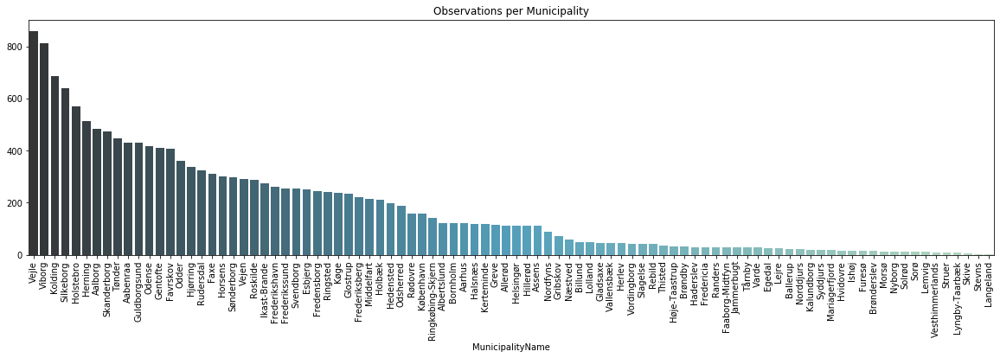

In [139]:
#Plotting the number of observations per Municipality
plt.figure(figsize=(20,5))
plt.title("Observations per Municipality")
df = traffic_data.groupby('MunicipalityName').FID.count().sort_values(ascending = False)
ax = sns.barplot(df.keys(), df.values, order=df.keys(), palette="GnBu_d")
plt.setp(ax.get_xticklabels(), rotation=90);

In [140]:
#Removing the municipalities that have less then 30 observations
obsmunicipalities = traffic_data.groupby('MunicipalityName').FID.count().sort_values(ascending = False)
selectedmunicipalities = list(obsmunicipalities[obsmunicipalities>30].index)
traffic_data = traffic_data[traffic_data.MunicipalityName.isin(selectedmunicipalities)]

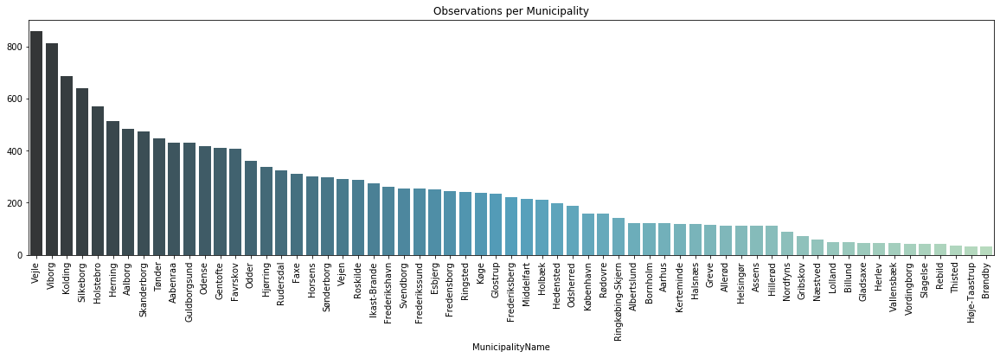

In [141]:
#Plotting the number of observations per Selected municipalities
plt.figure(figsize=(20,5))
plt.title("Observations per Municipality")
df = traffic_data.groupby('MunicipalityName').FID.count().sort_values(ascending = False)
ax = sns.barplot(df.keys(), df.values, order=df.keys(), palette="GnBu_d")
plt.setp(ax.get_xticklabels(), rotation=90);

#### Other variables
We then explore the other variables, by displaying the  summary statistics and investigating potential erros.

In [142]:
traffic_data.describe()

,RoadManager,Kilometer,Meter,Municipality,Year,AverageDailyVehicles,AverageWeekdayDailyVehicles,DailyJulyTraffic,AverageSpeed,CountedDays,AverageDailyTrucks,SpeedLimit,Quantile15,Quantile85,PctOverSpeedLimit,PctOverSpeedLimit10,PctOverSpeedLimit20,PctOfTrucks,Longitude
count,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000,15653.000000
mean,469.304095,8.850955,379.577333,526.302434,2016.697758,3778.110905,4186.496838,3545.200473,50.861100,16.456398,328.870504,61.455057,40.816738,60.506210,25.526953,7.871590,2.261675,7.664422,10.450671
std,268.772851,30.361906,281.610034,221.825670,2.810015,8607.585843,9452.833043,8567.165523,19.354803,26.259204,1042.094475,20.141757,17.731612,21.311722,25.385860,12.092178,5.441748,5.865497,1.370574
min,0.000000,0.000000,0.000000,101.000000,2000.000000,0.000000,0.000000,0.000000,8.200000,1.300000,-74.000000,15.000000,6.600000,9.500000,0.000000,-7.700000,-17.200000,-3.100000,8.114568
25%,230.000000,0.000000,140.000000,320.000000,2015.000000,479.000000,528.000000,419.000000,37.300000,7.000000,26.000000,50.000000,27.600000,46.000000,2.400000,0.300000,0.100000,3.900000,9.437380
50%,550.000000,0.000000,313.000000,580.000000,2017.000000,1349.000000,1500.000000,1203.000000,48.000000,7.900000,83.000000,50.000000,38.800000,56.900000,17.600000,2.700000,0.500000,6.700000,9.947871
75%,710.000000,3.000000,600.000000,727.000000,2019.000000,3829.000000,4287.000000,3439.000000,61.300000,10.700000,261.000000,80.000000,49.400000,72.800000,43.500000,10.700000,2.200000,9.900000,11.950020
max,860.000000,342.000000,3300.000000,860.000000,2020.000000,134915.000000,144973.000000,138913.000000,120.500000,365.800000,29273.000000,801.000000,102.400000,137.700000,99.500000,98.200000,93.400000,115.900000,15.149853


Below are some key takeaways from the summary statistics, which may be cause for furhter investigation.
* `Kilometer:` The maximum distance is 645, indicating that there is a measuring station 645 kilometers from the start of the road. This number is very high as roads in Denmark are not this long.
* `AverageDailyVehicles:` The minimum-value observation for the Average Daily Vehicles is negative, which should not be possible. The same is the case for `AverageWeekdayDailyVehicles`, `DailyJulyTraffic`, `PctOverSpeedLimit`, `PctOverSpeedLimit10`, `PctOverSpeedLimit20` and `PctOfTrucks`.
* `PctOfTrucks:` The maximum value for the Percantage of trucks on a road exceeds 100 % which should not be possible.
* `AverageWeekdayDailyVehicles:` Some maximum values for the daily number of vehicles are very high, but when compared to statistics from https://www.vejdirektoratet.dk/side/trafikkens-udvikling-i-tal, it is in accordance with the most populated roads in Denmark (Køge Bugt Motorvejen, Motorring 3)
* `SpeedLimit:` The maximum value is 801, which is indeed an odd speed limit.

Let's have a deeper look into some of these suspicious measurements. Let's look at the 645 km long road.

In [143]:
traffic_data[traffic_data["Kilometer"] == traffic_data["Kilometer"].max()]

,FID,Dataowner,RoadManager,RoadId,RoadPartId,RoadName,Kilometer,Meter,Location,Municipality,TypeOfVehicle,Year,AverageDailyVehicles,AverageWeekdayDailyVehicles,DailyJulyTraffic,Traffictype,AverageSpeed,CountedDays,AverageDailyTrucks,SpeedLimit,Quantile15,Quantile85,PctOverSpeedLimit,PctOverSpeedLimit10,PctOverSpeedLimit20,PctOfTrucks,Coordinates,Longitude,Latitude,MunicipalityName
15339,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,80,12,Frederikshavnmotorvejen,342.0,270.0,Sideanlæg: Øksenhede Vest,813.0,MOTORKTJ,2016,161.0,163.0,234.0,UDPR FERIE,58.9,13.6,17.0,130,42.0,84.4,0.6,-2.5,-5.7,10.3,POINT (587721.0000033564 6357194.99974163),10.457762,57.34916415365037,Frederikshavn


A quick google search indicates that Frederikshavnmotorvejen is indeed not 645 kilometers. The longest road in Denmark is 310 kilometers, and it is the E45 high-speed road. (Ref: https://da.wikipedia.org/wiki/Motorveje_i_Danmark). Let's see how many roads exceed this number in the data set.

In [144]:
print("Amount of measurements stations placed more than 310 kilometers away from start of road: {}".format(sum(traffic_data["Kilometer"] > 310)))

Amount of measurements stations placed more than 310 kilometers away from start of road: 8


It is hard to say if these roads are faulty measurements as the documentation for the Kilometer variable reads : The mileage indication - the counting point has a so-called mileage (stationing), which is _typically_ the distance from the start of the road to the counting point; The mileage is then the mileage part of the mileage.
We therefore choose not to keep observations with high values for Kilometer in further analysis.

Below are counts for negative observations for columns which shouldn't contain negative values. The counts for observations exceeding 100 % in `PctOfTrucks` are also shown. Observations with speeding limits higher than 130 are also counted.

In [145]:
print("Amount of negative observations in AverageDailyVehicles columns: {}".format(sum(traffic_data["AverageDailyVehicles"] < 0)))
print("Amount of negative observations in AverageWeekdayDailyVehicles columns: {}".format(sum(traffic_data["AverageWeekdayDailyVehicles"] < 0)))
print("Amount of negative observations in DailyJulyTraffic columns: {}".format(sum(traffic_data["DailyJulyTraffic"] < 0)))
print("Amount of negative observations in AverageDailyTrucks columns: {}".format(sum(traffic_data["AverageDailyTrucks"] < 0)))
print("Amount of negative observations in PctOverSpeedLimit10 columns: {}".format(sum(traffic_data["PctOverSpeedLimit10"] < 0)))
print("Amount of negative observations in PctOverSpeedLimit20 columns: {}".format(sum(traffic_data["PctOverSpeedLimit20"] < 0)))
print("Amount of negative observations in PctOfTrucks columns: {}".format(sum(traffic_data["PctOfTrucks"] < 0)))
print("Amount of observations exceeding 100 % PctOfTrucks columns: {}".format(sum(traffic_data["PctOfTrucks"] > 100)))
print("Amount of observations exceeding a speeding limit of 130: {}".format(sum(traffic_data["SpeedLimit"] > 130)))

Amount of negative observations in AverageDailyVehicles columns: 0
Amount of negative observations in AverageWeekdayDailyVehicles columns: 0
Amount of negative observations in DailyJulyTraffic columns: 0
Amount of negative observations in AverageDailyTrucks columns: 1
Amount of negative observations in PctOverSpeedLimit10 columns: 17
Amount of negative observations in PctOverSpeedLimit20 columns: 25
Amount of negative observations in PctOfTrucks columns: 1
Amount of observations exceeding 100 % PctOfTrucks columns: 1
Amount of observations exceeding a speeding limit of 130: 1


The majority of observations are positive, with only a few negative ones. The observations are replaced with NaN values.

In [146]:
num = traffic_data._get_numeric_data()
num[num < 0] = np.nan
if traffic_data.PctOfTrucks.max() > 100:
    traffic_data.PctOfTrucks.replace([traffic_data.PctOfTrucks.max()], np.nan, inplace = True)
if traffic_data.SpeedLimit.max() > 130:
    traffic_data.SpeedLimit.replace([traffic_data.SpeedLimit.max()], np.nan, inplace = True)

#### Number of observations per Year

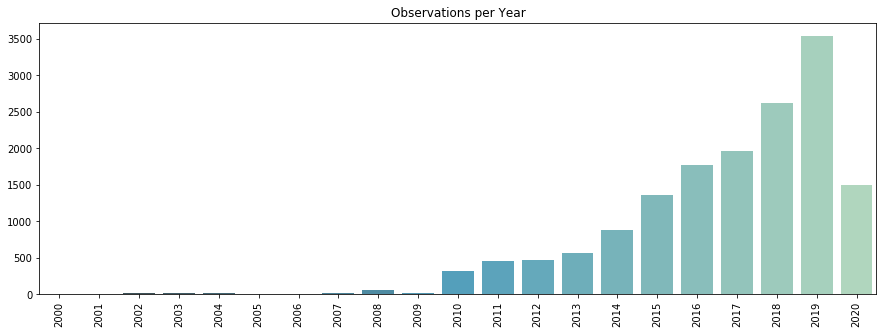

In [147]:
plt.figure(figsize=(15,5))
plt.title("Observations per Year")
df = traffic_data.Year.value_counts()
ax = sns.barplot(df.keys(), df.values, order=df.keys().sort_values(), palette="GnBu_d")
plt.setp(ax.get_xticklabels(), rotation=90);

The years going from 2000 to 2009 present very few observations and we therefore decided to focus our analysis on data from years going from 2010 onwards.

In [148]:
#removing observation dating before 2010
traffic_data = traffic_data[traffic_data.Year > 2009]

#### Overview of the observations

In [149]:
#Plotting all observations
map_obs = folium.Map(location=[56.2325, 10.7922], zoom_start = 7)
for index, row in traffic_data.iterrows():
    folium.Circle([row.Latitude, row.Longitude],radius = 1, opacity = 0.2 , popup=row.Location).add_to(map_obs)
map_obs

This overview of observations location shows some blank spots which indicate areas/municipalities with no observations registered. Some of these are: *Hadersvel* and *Varde* (South of Jutland), *Ringe* (Middle of Fyn), *Sorø* (West of Sjælland). This shows that some areas of the country may need more monitoring and data measurements. The level of opcaity set to 0.2 allows to roughly identify the higher oservations density areas which matches with the presence of big cities such as Aalborg, Roskilde, Odense and the Copenhagen area.

## 2. Data manipulation

In order to extract some meaningful information from the variables in the data set, we create two new variables. More specifically, we compute:
- `AverageDifferenceSpeedLimitAvgSpeed`: difference between the speed limit and the average speed. This is useful to assess how close to the speed limit the people drive on a specific road. Indeed, looking at the average speed alone, without considering the speed limit, provides limited information.
- `JulyWeekdaysRatio`: ratio between the number of vehicles in a day in July and the number of vehicles in a working day. This is interesting to analyse the variation in the number of vehicles in different times of the year.

In [150]:
#Creating the first variable

traffic_data = traffic_data.dropna(subset=['SpeedLimit', 'AverageSpeed'])
#traffic_data = traffic_data.astype({'SpeedLimit': 'float64'})
traffic_data["AverageDifferenceSpeedLimitAvgSpeed"] =  traffic_data.SpeedLimit - traffic_data.AverageSpeed

In [151]:
#Creating the second variable

#We exclude data points where AverageWeekdayDailyVehicles is 0 as to not to divide by 0 - a total of 3 observations have 0-values in AverageWeekdayDailyVehicles.
traffic_data = traffic_data[traffic_data.AverageWeekdayDailyVehicles != 0].reset_index(drop=True)
traffic_data["JulyWeekdaysRatio"] = traffic_data.DailyJulyTraffic / traffic_data.AverageWeekdayDailyVehicles

## 3. Summary statistics and variable distributions

In [152]:
traffic_data.describe()

,RoadManager,Kilometer,Meter,Municipality,Year,AverageDailyVehicles,AverageWeekdayDailyVehicles,DailyJulyTraffic,AverageSpeed,CountedDays,AverageDailyTrucks,SpeedLimit,Quantile15,Quantile85,PctOverSpeedLimit,PctOverSpeedLimit10,PctOverSpeedLimit20,PctOfTrucks,Longitude,AverageDifferenceSpeedLimitAvgSpeed,JulyWeekdaysRatio
count,15458.000000,15458.000000,15458.000000,15458.000000,15458.000000,15458.000000,15458.000000,15458.000000,15458.000000,15458.000000,15457.000000,15458.000000,15458.000000,15458.000000,15458.000000,15441.000000,15433.000000,15456.000000,15458.000000,15458.000000,15458.000000
mean,469.721568,8.862078,379.291823,527.438931,2016.835360,3799.328503,4212.237547,3558.112887,50.822092,16.497891,330.318044,61.412537,40.803810,60.442742,25.433769,7.809552,2.240051,7.624554,10.449590,10.590445,0.818764
std,269.973528,30.500057,281.456968,222.425775,2.519844,8656.074883,9505.953067,8615.107959,19.371148,26.286268,1048.212888,19.310899,17.746424,21.323645,25.342260,11.999525,5.346207,5.802370,1.363711,13.167615,0.241416
min,0.000000,0.000000,0.000000,101.000000,2010.000000,1.000000,1.000000,0.000000,8.200000,1.300000,0.000000,15.000000,6.600000,9.500000,0.000000,0.000000,0.000000,0.000000,8.114568,-39.000000,0.000000
25%,230.000000,0.000000,140.000000,320.000000,2015.000000,479.000000,529.000000,417.000000,37.300000,7.000000,26.000000,50.000000,27.500000,45.900000,2.400000,0.300000,0.100000,3.900000,9.440153,1.400000,0.719010
50%,550.000000,0.000000,313.000000,580.000000,2017.000000,1353.000000,1503.000000,1198.000000,48.000000,7.900000,82.000000,50.000000,38.800000,56.900000,17.500000,2.700000,0.500000,6.600000,9.948360,8.600000,0.755683
75%,710.000000,3.000000,600.000000,727.000000,2019.000000,3837.750000,4297.750000,3436.750000,61.200000,10.700000,260.000000,80.000000,49.300000,72.700000,43.400000,10.600000,2.100000,9.900000,11.944586,18.000000,0.828463
max,860.000000,342.000000,3300.000000,860.000000,2020.000000,134915.000000,144973.000000,138913.000000,120.500000,365.800000,29273.000000,130.000000,102.400000,137.700000,99.500000,98.200000,93.400000,99.000000,15.149853,99.700000,5.969203


As seen from the summary statistics table, the processed data set has been reduced to contain 15652 observations. It it is noted that none of the observations are subceeding or exceeding reasonable limits for the given variable. This is of coruse not a guarantee that the observations are free from errors or potential outliers, but rather that the obvious ones were removed.

Having a closer look at the variables `Kilometer`, `CountedDays` and the variables denoting the amount of vehicles and speeding vehicles, we see that their maximum values are far from the Inter Quartile Range, indicating that few observations have very large values - in other words, some few roads have very different behaviours compared to the majority of roads. This could be due to the large difference in traffic levels when comparing low capacity roads such as urban streets with highways. A potential casue for roads with a lot of speeding could be due to incorrect speed limits, or lack of transparency for the particular speed limit.

Below are histograms for a subset of the variables which we find interesting.

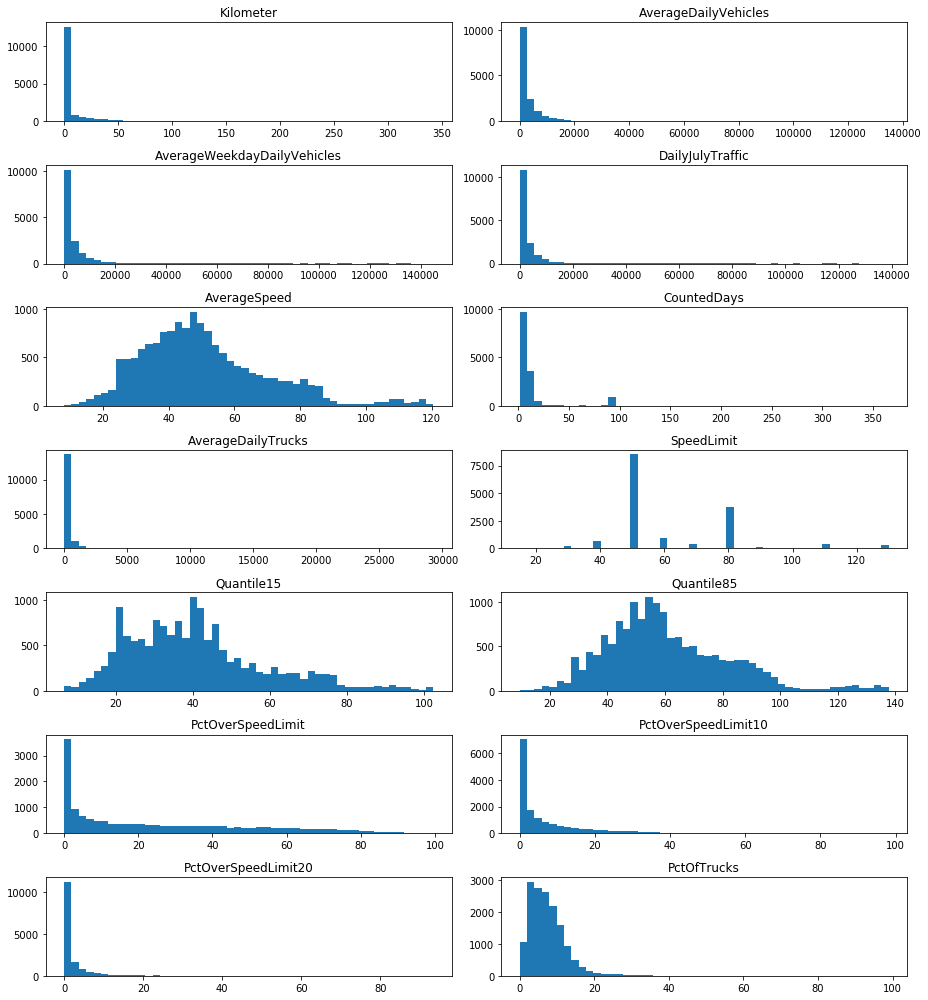

In [153]:
cols_to_plot = ['Kilometer', 'AverageDailyVehicles',
       'AverageWeekdayDailyVehicles', 'DailyJulyTraffic',
       'AverageSpeed', 'CountedDays',
       'AverageDailyTrucks', 'SpeedLimit', 'Quantile15', 'Quantile85',
       'PctOverSpeedLimit', 'PctOverSpeedLimit10', 'PctOverSpeedLimit20',
       'PctOfTrucks'] #ADD NEW VARIABLES

fig = plt.figure(figsize=(13,14))
for i in range(len(cols_to_plot)):
    fig.add_subplot(7, 2, i+1)
    plt.hist(pd.to_numeric(traffic_data[cols_to_plot[i]]), bins = 50)
    plt.title(cols_to_plot[i])
    plt.tight_layout()
    
plt.show()

As suspected by looking at the summary statistics, many of the variables are not normally distributed have tendencies to have long tails to the right, which indicate that there are some few high valued observations for many of them. Despite these being outliers compared to the rest of the data, the values are still seen as realistic, and therefore kept in the data set for further analysis.

Only a few variables, all related to speed (`Average speed`, `Quantile15`, `Quantile85`), have a distribution that resembles the normal distribution. Indeed, it is reasonable to expect that, when considering the driving speed, a majority of people will drive at a similar speed, and a fewere percentage will drive either slower or faster (i.e. the two tails of the normal distribution).

These observations are confirmed by the Q-Q plots below.

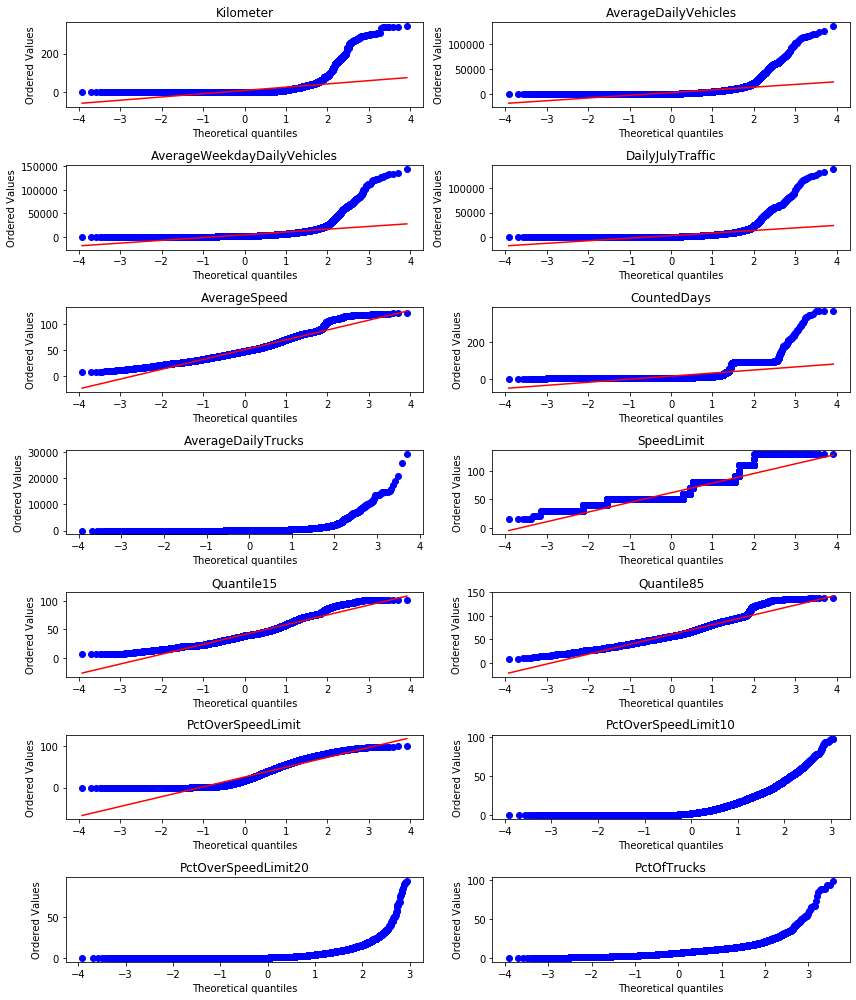

In [154]:
fig = plt.figure(figsize=(12,14))
for i in range(len(cols_to_plot)):
    fig.add_subplot(7, 2, i+1)
    df = traffic_data[cols_to_plot[i]]
    stats.probplot(df, dist="norm", plot=plt)
    plt.title(cols_to_plot[i])
    plt.tight_layout()

## 4. Data Exploration

### 4A. Temporal trends
We firstly explore whether the behavior of Danes has changed througout the last 10 years. Since most of the variables are not normally distributed, we compare the yearly median values.

In [155]:
vars_to_plot = ['AverageDailyVehicles', 'AverageSpeed', 'PctOfTrucks', 
                'PctOverSpeedLimit', 'PctOverSpeedLimit20', 'AverageDifferenceSpeedLimitAvgSpeed']

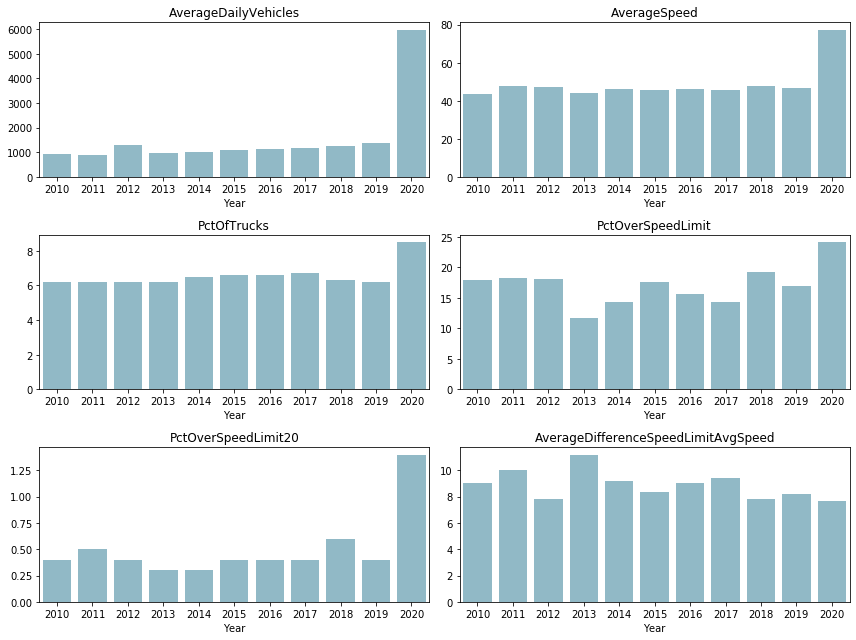

In [156]:
#Plotting the median yearly value of some interesting variables

fig = plt.figure(figsize=(12,9))
for i in range(len(vars_to_plot)):
    fig.add_subplot(3, 2, i+1)
    df = traffic_data.groupby('Year')[vars_to_plot[i]].median()
    sns.barplot(df.keys(), df.values, color = "#88bdcf")
    plt.title(vars_to_plot[i])
    plt.tight_layout()
    
plt.show()

For 5 out of 6 variables, the median for 2020 is unexpectedly higher than the medians in the previous years. Specifically, the `AverageDailyVehicles` and the `AverageSpeed` variables take relatively stable values throughout the years, but register a peak in 2020. Therefore, in the cells below, we will focus on those two variables and check if this is due to data errors (i.e. irreasonably high numbers recorded in 2020) or if the entire distribution in 2020 is shifted towards higher values and the average reflects that distribution.

#### Average Speed

In [157]:
#Checking the maximum average speed recorded in the last 4 years
for i in [2017,2018,2019,2020]:
    print("Maximum average speed registered in {}: {}".format(i,traffic_data[traffic_data.Year == i].AverageSpeed.max()))

Maximum average speed registered in 2017: 90.4
Maximum average speed registered in 2018: 114.3
Maximum average speed registered in 2019: 115.9
Maximum average speed registered in 2020: 120.5


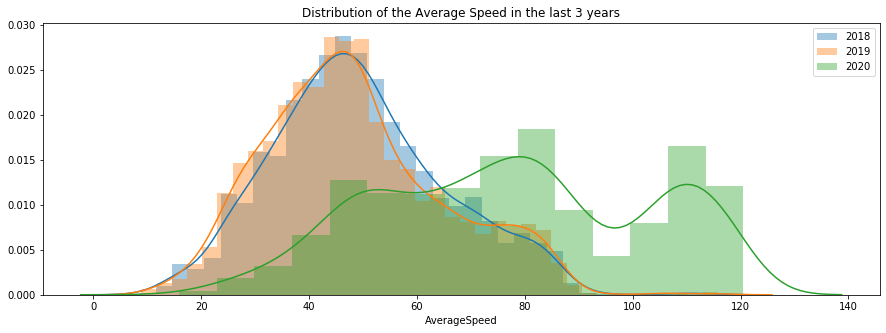

In [158]:
#Plotting the distribution of the average speed in the last 3 years
plt.figure(figsize=(15,5))
for i in [2018,2019,2020]:
    sns.distplot(traffic_data[traffic_data.Year == i]["AverageSpeed"], label= i)
    plt.title("Distribution of the Average Speed in the last 3 years")
    plt.legend()

#### Number of Vehicles

In [159]:
#Checking the maximum number of vehicles recorded in the last 4 years
for i in [2017,2018,2019,2020]:
    print("Maximum numbers of vehicles registered in {}: {}".format(i,traffic_data[traffic_data.Year == i].AverageDailyVehicles.max()))

Maximum numbers of vehicles registered in 2017: 33729.0
Maximum numbers of vehicles registered in 2018: 101195.0
Maximum numbers of vehicles registered in 2019: 116145.0
Maximum numbers of vehicles registered in 2020: 134915.0


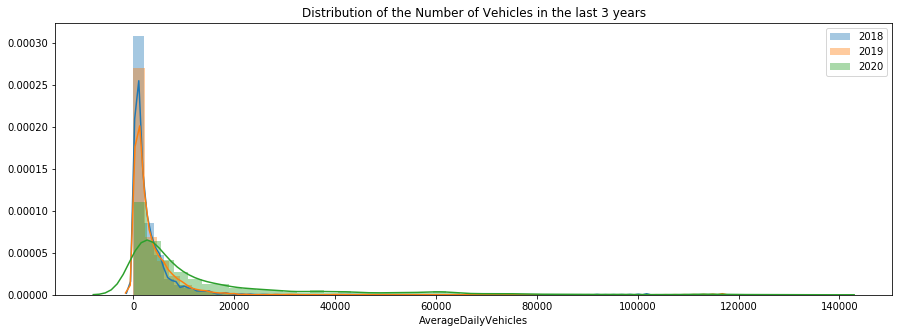

In [160]:
#Plotting the distribution of the average number of daily vehicles in the last 3 years
plt.figure(figsize=(15,5))
for i in [2018,2019,2020]:
    sns.distplot(traffic_data[traffic_data.Year == i]["AverageDailyVehicles"], label= i)
    plt.title("Distribution of the Number of Vehicles in the last 3 years")
    plt.legend()

As it can be seen, both for the `AverageDailyVehicles` and the `AverageSpeed` variables, the peaks in 2020 does not seem to be due to irreasonably high values. Instead, the peak might be due to different types of streets being measured. Indeed, for instance, if more measurements in 2020 were performed in highways, the resulting average speed and number of vehicles would be higher. 

We can verify this hypothesis by comparing the `SpeedLimit` variable throughout the years, which gives us an indication about the types of roads where the measurements have been performed.

#### Speed Limit

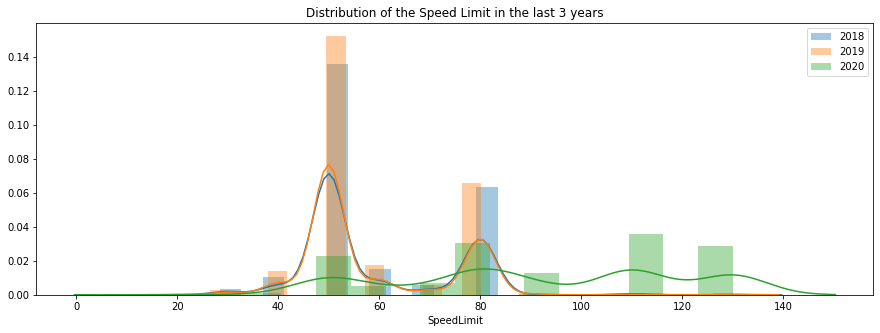

In [161]:
#Plotting the distribution of the speed limit in the last 3 years
plt.figure(figsize=(15,5))
for i in [2018,2019,2020]:
    sns.distplot(traffic_data[traffic_data.Year == i]["SpeedLimit"], label= i)
    plt.title("Distribution of the Speed Limit in the last 3 years")
    plt.legend()

While in the previous years the measurements have been performed in roads that have a speed limit lower than 80km/h, in 2020 a substantial fraction of measurements has been performed in high-speed roads. 
Therefore, the main increase in speed might be driven by a difference in the sample of roads.

To test that, we plot the median value of some variables throughout the years, by only considering urban roads (`SpeedLimit` lower than 51km/h). 

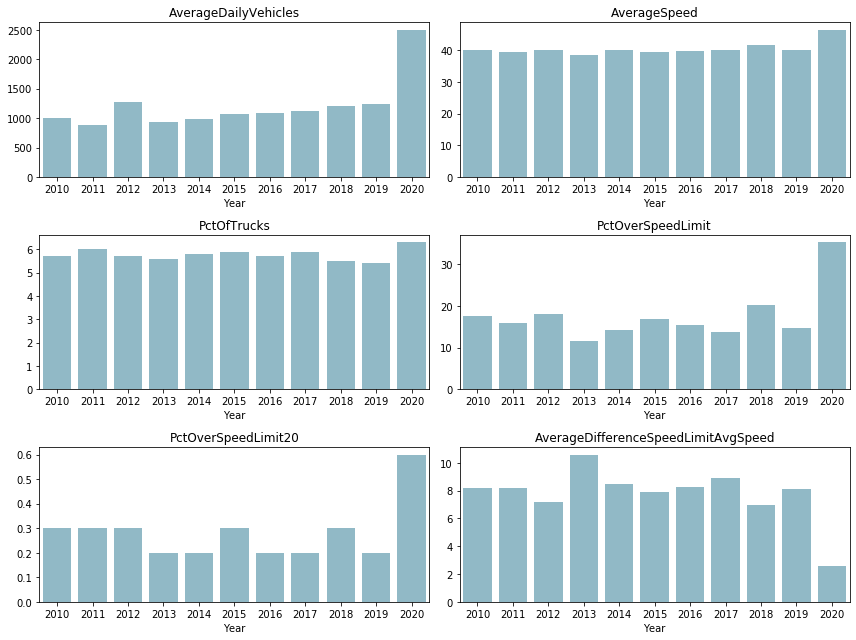

In [162]:
fig = plt.figure(figsize=(12,9))
for i in range(len(vars_to_plot)):
    fig.add_subplot(3, 2, i+1)
    df = traffic_data[traffic_data.SpeedLimit<51].groupby('Year')[vars_to_plot[i]].median()
    sns.barplot(df.keys(), df.values, color = "#88bdcf")
    plt.title(vars_to_plot[i])
    plt.tight_layout()
    
plt.show()

For some variables (`AverageSpeed`, `PctOfTrucks`), the high 2020 median value is, to a great extent, explained by the higher number of high-speed roads been measured. Indeed, when only considering the urban roads, the 2020 median is closer to the one from the previous years.

However, for the other variables (e.g. `AverageDailyVehicles` and `PctOverSpeedLimit`), even when considering only urban roads, the median value registered in 2020 is considerably higher than the one registered in the previous years. A reason for this might be that the measurements have been performed in different (more trafficated) roads, within the urban category, compared to the previous years.

In [163]:
# fig = plt.figure(figsize=(12,9))
# for i in range(len(vars_to_plot)):
#     fig.add_subplot(3, 2, i+1)
#     sns.boxplot(traffic_data['Year'], traffic_data[vars_to_plot[i]][traffic_data.SpeedLimit<51], palette="GnBu_d")
#     plt.title(vars_to_plot[i])
#     plt.tight_layout()
    
# plt.show()

### 4B. Comparison among municipalities
We then explore some traffic patterns, by comparing the values taken by some variables in the different Danish municipalities:
- What municipalities register a higher/lower number of vehicles (`AverageDailyVehicles`)?
- What municipalities register a higher/lower number and percentage of trucks (`AverageDailyTrucks`, `PctOfTrucks`)?
- What municipalities register an increase/decreas in the number of vehicles in July, compared to a standard working day (`JulyWeekdaysRatio`)?

In [164]:
#Configuring GeoPandas
dk = gpd.read_file('./dataset/denmark-municipalities.geojson')
dk = dk.rename(columns={"name": "MunicipalityName"})
dk.MunicipalityName = dk.MunicipalityName.str.replace(" Kommune", "")
dk.MunicipalityName = dk.MunicipalityName.str.replace("Københavns", "København")
dk.MunicipalityName = dk.MunicipalityName.str.replace("Bornholms Regionskommune", "Bornholm")
#dk = dk[dk.MunicipalityName != "Bornholms Regionskommune"]

#### Number of vehicles

In [165]:
#Calculate average for AverageDailyVehicles for municipality
df = traffic_data.groupby('MunicipalityName').AverageDailyVehicles.mean().sort_values(ascending = False)
df.head(10)

MunicipalityName
Brøndby          44147.419355
Gladsaxe         25643.755556
Høje-Taastrup    21827.531250
Aarhus           16186.283333
Slagelse         15978.976190
Vallensbæk       12544.422222
Greve            11542.834783
Køge             11171.364641
Rebild           10799.609756
Herlev            7642.311111
Name: AverageDailyVehicles, dtype: float64

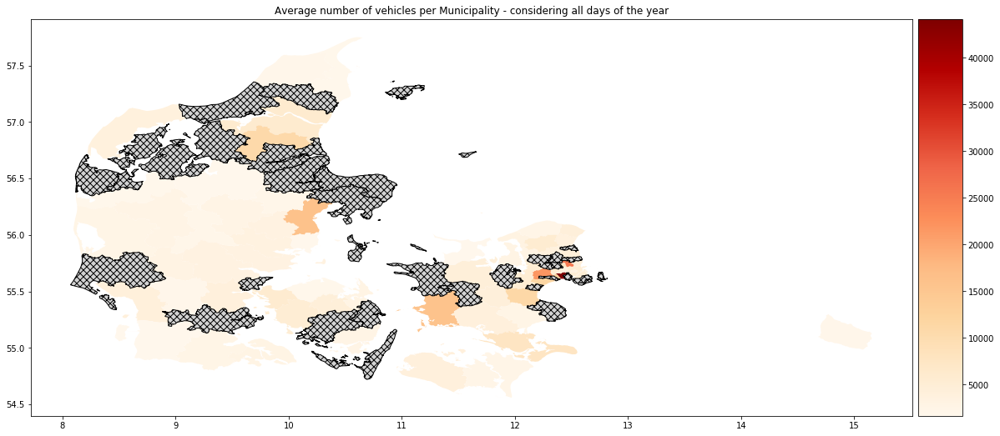

In [166]:
#Display the average number of vehicles per Municipality in a map
merged = pd.merge(dk, pd.DataFrame(df).reset_index(), how="outer")
fig, ax = plt.subplots(1,1, figsize=(20,10))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
ax.set_title(f"Average number of vehicles per Municipality - considering all days of the year")
merged.plot(column="AverageDailyVehicles",
            ax=ax,
            legend=True,
            cax=cax,
            cmap='OrRd',
            missing_kwds={
            "color": "lightgrey",
            "edgecolor": "black",
            "hatch": "xxx",
            "label": "Missing values",
            })

The municipalities with highest average daily number of vehicles are **Brøndby, Gladsaxe and Høje-Taastrup**. This does not surprise given the proximity to Copenhagen and high industry/business present in that area. **Aarhus** is also in the top 10, again not surprising given it being a big city. An interesting fact is that **Slagelse** has also a very high average value, this could be due to its position close to the border towards Fyn and the presence of the Great Belt Bridge, so this could be the result of many commuters driving by or trucks transporting goods.

#### Number and percentage of trucks

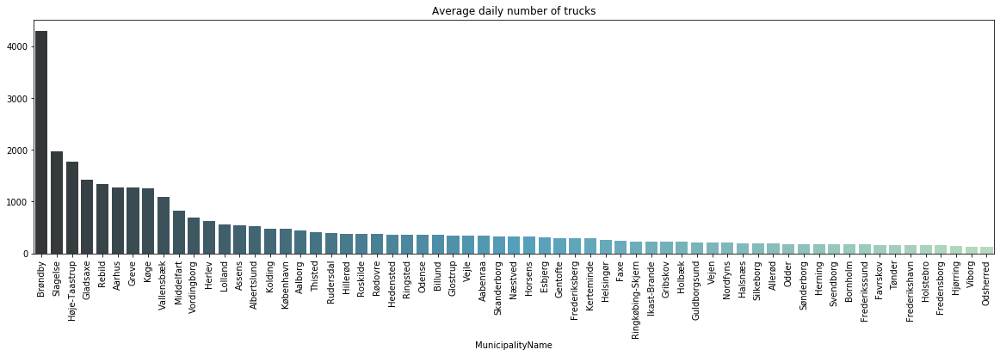

In [167]:
plt.figure(figsize=(20,5))
plt.title("Average daily number of trucks")
df = traffic_data.groupby('MunicipalityName').AverageDailyTrucks.mean().sort_values(ascending = False)
ax = sns.barplot(df.keys(), df.values, order = df.keys(), palette="GnBu_d")
plt.setp(ax.get_xticklabels(), rotation=90);

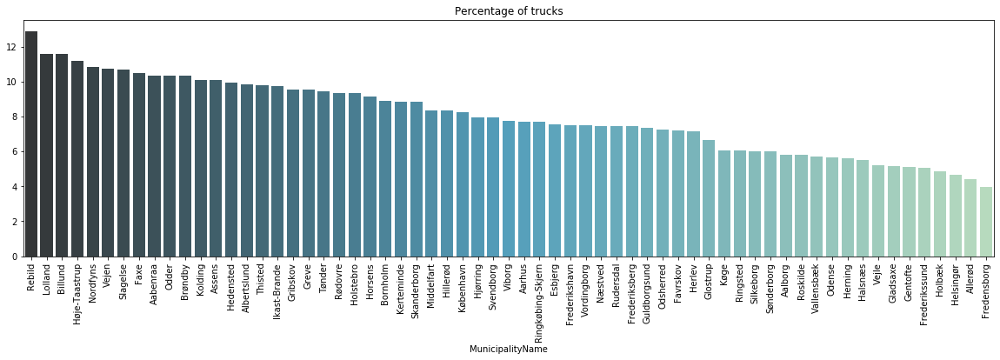

In [168]:
plt.figure(figsize=(20,5))
plt.title("Percentage of trucks")
df = traffic_data.groupby('MunicipalityName').PctOfTrucks.mean().sort_values(ascending = False)
ax = sns.barplot(df.keys(), df.values, order = df.keys(), palette="GnBu_d")
plt.setp(ax.get_xticklabels(), rotation=90);

#### Number of vehicles in July vs a working day

In [169]:
df = (traffic_data.groupby('MunicipalityName').DailyJulyTraffic.mean() / traffic_data.groupby('MunicipalityName').AverageWeekdayDailyVehicles.mean()).sort_values(ascending = False)
df.head(10)

MunicipalityName
Odsherred        1.269833
Vordingborg      1.073189
Frederikshavn    1.064219
Rebild           1.063473
Bornholm         1.060047
Lolland          1.039421
Thisted          0.994785
Gribskov         0.978452
Billund          0.974658
Slagelse         0.974221
dtype: float64

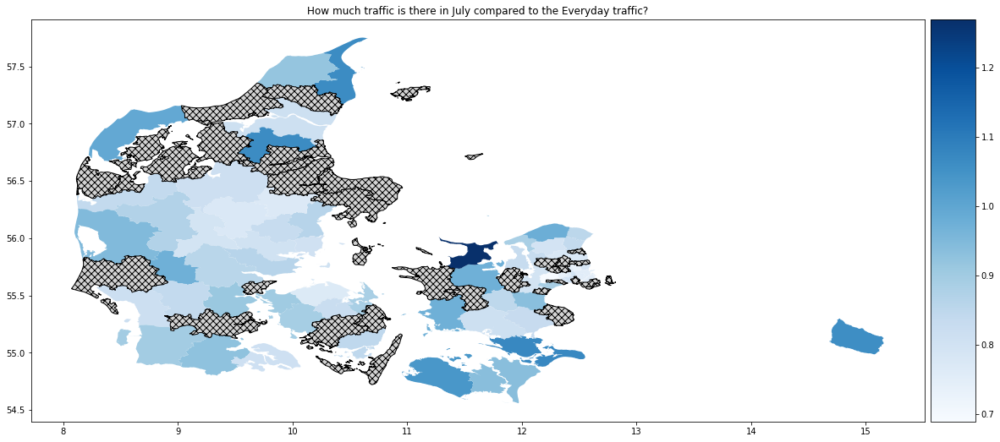

In [170]:
merged = pd.merge(dk, pd.DataFrame(df, columns={"JulyEveryDayRatio"}).reset_index(), how="outer")
fig, ax = plt.subplots(1,1, figsize=(20,10))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
ax.set_title(f"How much traffic is there in July compared to the Everyday traffic?")
merged.plot(column="JulyEveryDayRatio",
            ax=ax,
            legend=True,
            cax=cax,
            cmap='Blues',
            missing_kwds={
            "color": "lightgrey",
            "edgecolor": "black",
            "hatch": "xxx",
            "label": "Missing values",
            })

Some municipalities (values <1) experience a drop in traffic in July, some (values >1) experience an increase in traffic in July.

Unsurprisingly the municipalities experiencing an increase in average daily vehicles are the ones close to the coast and known as holiday places: **Bornholm, Frederikshavn, Gribskov, Thisted**. Other such as **Slagelse, Rebild, Aabenraa** may indicate the increase affects also places close to regional and national borders, as people going on holidays drive by these municipalities. Aalborg could be expected to experience an increase as well since it is on the way from Rebild to the northern holiday places such as Frederikshavn and Hjørring, but this is not the case. This could be due to the fact that we are plotting the ratio between everyday traffic and the one in July. Aalborg is a big city and during July experiences a decrease compared to everyday even though it is traveled by turists driving north. 


# II. Explaining the driving behavior
## 1.  Addressing our research questions


### How does the driving behavior change in the different types of roads?

It is interesting to explore whether the behavior of Danes changes in the different types of roads. We can classify the roads based on the `SpeedLimit` values. Firstly, we look at the number of observations per `SpeedLimit` values.

In [171]:
#plt.figure(figsize=(15,4))
#df = traffic_data.SpeedLimit.value_counts()
#ax = sns.barplot(df.keys(), df.values, order=df.keys().sort_values(), color = "#88bdcf")
#plt.title("Observations per SpeedLimit");

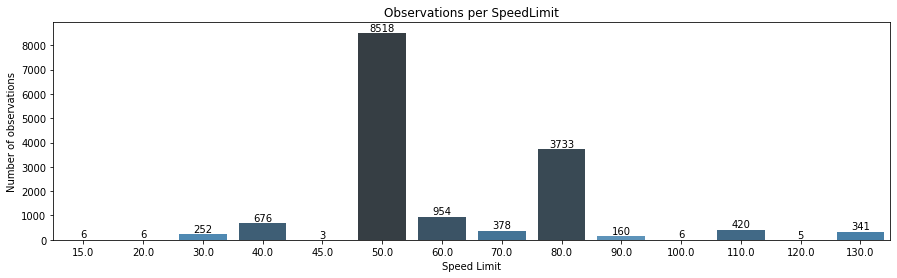

In [172]:
plt.figure(figsize=(15,4))
df=traffic_data.groupby('SpeedLimit').FID.count().reset_index()

pal = sns.color_palette("Blues_d", len(df.FID))
rank = df.FID.argsort().argsort() 
g=sns.barplot(df.SpeedLimit, df.FID, palette=np.array(pal[::-1])[rank])

for p in g.patches:
     g.annotate('{:.0f}'.format(p.get_height()), (p.get_x()+0.4, p.get_height()),
                    ha='center', va='bottom',
                    color= 'black')
g.set(ylabel='Number of observations', xlabel='Speed Limit')
plt.title("Observations per SpeedLimit");

plt.show()

We can see that there are 14 categories of roads (i.e. `SpeedLimit` values). The majority of the measurements has been performed in roads that have a `SpeedLimit`of either 50km/h or 80 km/h.

We now look into whether the behavior of Danes changes in the different types of roads. We remove the 5 categories that have few (<7) observations. Since most of the variables are not normally distributed, we compare the medians of the remaining 9 categories. 


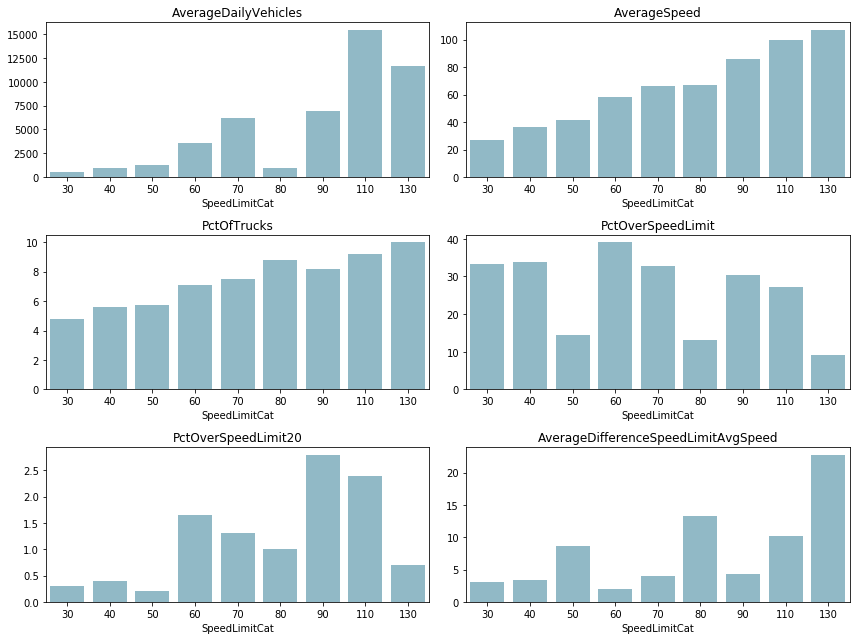

In [173]:
speedlimits = np.sort(traffic_data.SpeedLimit.unique().astype(int))
list_ordering = list(speedlimits)
a=[15,20,45,100,120]
list_ordering1 = [x for x in list_ordering if (x not in a)]
df = traffic_data[~traffic_data.SpeedLimit.isin(a)]
df["SpeedLimitCat"] = pd.Categorical(df["SpeedLimit"], categories=list_ordering1)

fig = plt.figure(figsize=(12,9))
for i in range(len(vars_to_plot)):
    fig.add_subplot(3, 2, i+1)
    df1 = df.groupby('SpeedLimitCat')[vars_to_plot[i]].median()
    sns.barplot(df1.keys(), df1.values, color = "#88bdcf")
    plt.title(vars_to_plot[i])
    plt.tight_layout()
    
plt.show()

In [174]:
#df = traffic_data.dropna(subset=['PctOfTrucks','PctOverSpeedLimit20']).reset_index(drop=True)

#for i in range(len(vars_to_plot)):
#    r, p, lower, upper = pearsonr_ci(df.SpeedLimit.values, df[vars_to_plot[i]])
#    print("Correlation between SpeedLimit and",vars_to_plot[i],":", r,"; P-value:", round(p, 3))

Clear patterns emerge from the plots above. We will discuss the patterns below and we will compute the correlation to test the relationship between the `SpeedLimit` variable and the other six variables. It is important to remember that the correlation depends on the roads that have a `SpeedLimit`of either 50km/h or 80 km/h, which represent the great majority in the data set.

- Larger roads (i.e. roads with higher `SpeedLimit`) tend to register a higher number of vehicles (`AverageDailyVehicles`) and a higher average speed (`AverageSpeed`). This is reasonable, given that larger roads are supposed to allow for higher speed limits (thus higher average speed) and to be used by a higher number of people. These trends are confirmed by statistically significant and high positive correlations:

|         Variables                       | Correlation coefficient | P-value |
|---------------------------------------------------------|-------------------|-------------------|
| SpeedLimit and AverageDailyVehicles :   | 0.404           | <0.001         |
| SpeedLimit and AverageSpeed : | 0.771           | <0.001           |

- Larger roads (i.e. roads with higher `SpeedLimit`, up to 90 km/h) tend to register a higher percentage of trucks (`PctOfTrucks`). Indeed, trucks are supposed to travel predominantly on larger roads, and sometimes they are not even allowed to travel in urban streets. This is confirmed by a positive correlation:

|         Variables                       | Correlation coefficient | P-value |
|---------------------------------------------------------|-------------------|-------------------|
| SpeedLimit and PctOfTrucks : | 0.202           | <0.001           |

- Denmark has three general speed limits (50 km/h within towns, 80 km/h outside towns, 130 km/h on motorways). Fewer people seem to drive above the speed limit (`PctOverSpeedLimit`) in the roads that those 3 standard speed limits. This might be due to the fact that those limits are well known and Danes are used to respect them. Overall, the two variables are slightly negatively correlated, suggesting that, slightly more people exceed the speed limit in smaller roads (i.e. roads with lower `SpeedLimit`):

|         Variables                       | Correlation coefficient | P-value |
|---------------------------------------------------------|-------------------|-------------------|
| SpeedLimit and PctOverSpeedLimit : | -0.081            | <0.001             |


- Larger roads tend to register a higher percentage of drivers that exceed the speed limit by more than 20km/h (`PctOverSpeedLimit20`). This might be due to the fact that 20 km/h is a relatively smaller increase when driving at a higher speed. However, this is not the case for the roads with speed limit of 130 km/h, which register a lower percentage. This can be explained by the approaching of an upper speed limit, in terms of car performances and drivers' habits. Indeed, only a fraction of cars can exceed 150km/h and people are not used to drive that fast. 
As a result of these two trends, the correlation is only slightly positive:

|         Variables                       | Correlation coefficient | P-value |
|---------------------------------------------------------|-------------------|-------------------|
| SpeedLimit and PctOverSpeedLimit20 : | 0.056            | <0.001             |

- Larger roads seem to register a bigger difference between the speed limit and the average speed (`AverageDifferenceSpeedLimitAvgSpeed`). Indeed, when the speed limit is very low (`SpeedLimit` < 50 km/h), people drive faster or only slightly slower than the speed limit. As the speed limit increases, the vehicles tend to drive more and more slow compared to the speed limit (i.e. the difference increases). This relationship is confirmed by a statistically significant and positive correlation:

|         Variables                       | Correlation coefficient | P-value |
|---------------------------------------------------------|-------------------|-------------------|
| SpeedLimit and AverageDifferenceSpeedLimitAvgSpeed  : | 0.321            | <0.001             |

Finally, in addition to investigating how the median of each type of road varies based on the other variables, we can also analyse the relationship the variables `AverageDailyVehicles`, `AverageSpeed`, `PctOverSpeedLimit`, `PctOverSpeedLimit20`, across all the road types.

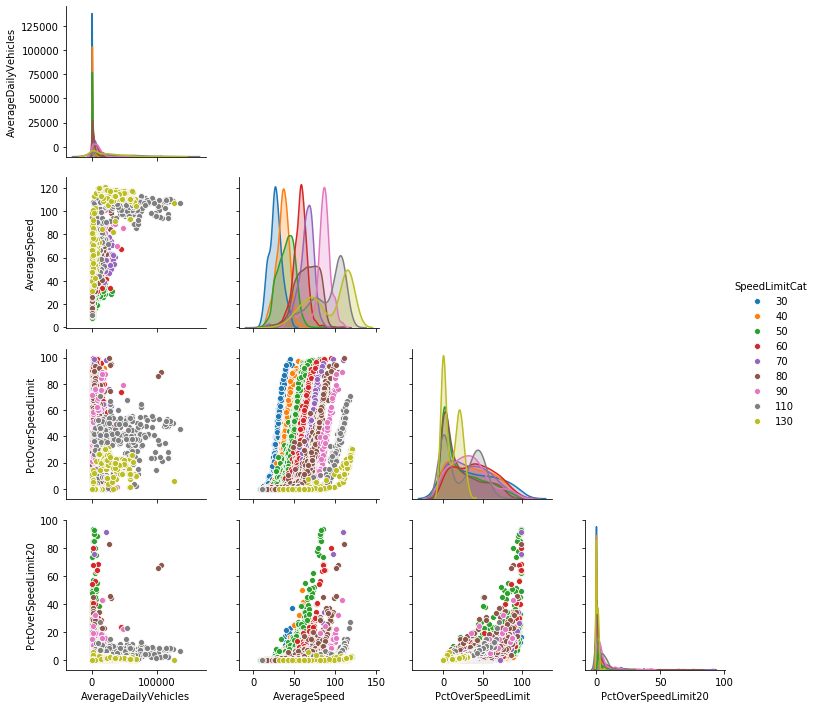

In [175]:
#import seaborn as sns; sns.set(style="ticks", color_codes=True)
def hide_current_axis(*args, **kwds):
    plt.gca().set_visible(False)

g = sns.pairplot(df, vars = ['AverageDailyVehicles', 'AverageSpeed', 
                            'PctOverSpeedLimit', 'PctOverSpeedLimit20'], hue="SpeedLimitCat")

g.map_upper(hide_current_axis)


In [176]:
# df1 = df.dropna(subset=['AverageDailyVehicles', 'AverageSpeed', 
#                             'PctOverSpeedLimit', 'PctOverSpeedLimit20']).reset_index(drop=True)

# r, p, lower, upper = pearsonr_ci(df1.AverageSpeed.values, df1.AverageDailyVehicles)
# print("Correlation between AverageSpeed and AverageDailyVehicles",":", r,"; P-value:", round(p, 3))
# r, p, lower, upper = pearsonr_ci(df1.AverageSpeed.values, df1.PctOverSpeedLimit)
# print("Correlation between AverageSpeed and PctOverSpeedLimit",":", r,"; P-value:", round(p, 3))
# r, p, lower, upper = pearsonr_ci(df1.AverageSpeed.values, df1.PctOverSpeedLimit20)
# print("Correlation between AverageSpeed and PctOverSpeedLimit20",":", r,"; P-value:", round(p, 3))

Although, as seen above, the `PctOverSpeedLimit` is not highly correlated with the type of road (`SpeedLimit`), it is highly correlated with the `AverageSpeed`.  Larger roads do not have a higher percentage of drivers over the speed limit, but roads with higher average speed register a higher percentage of drivers over the speed limit.
This might be due to the fact that the people that exceed the speed limit cause an increase in the average speed, but do not influence the speed limit.

|         Variables                       | Correlation coefficient | P-value |
|---------------------------------------------------------|-------------------|-------------------|
| AverageSpeed  and PctOverSpeedLimit  : | 0.472            | <0.001             |

### Which municipalities register the highest/lowest average speed?

It is interesting to investigate how the average speed varies throughout the Danish municipalities.

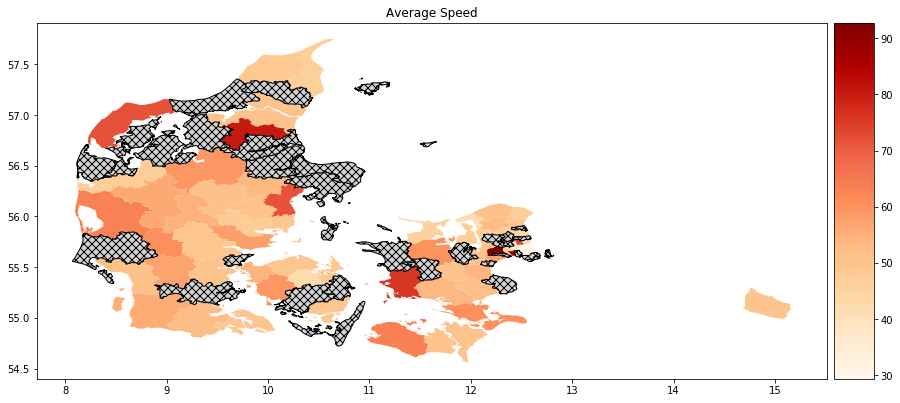

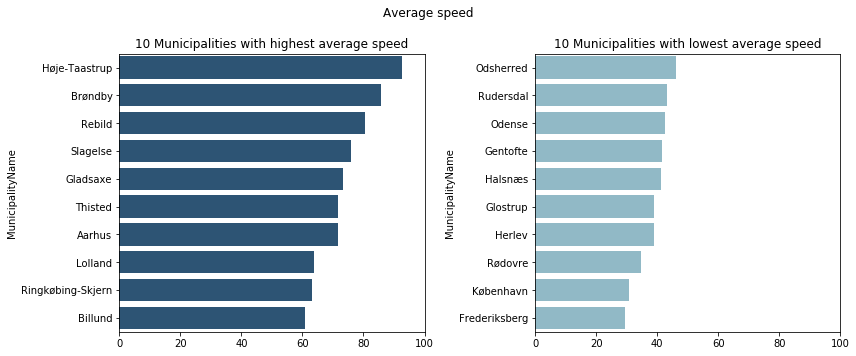

In [177]:
df = traffic_data.groupby('MunicipalityName').AverageSpeed.mean().sort_values(ascending = False)

merged = pd.merge(dk, pd.DataFrame(df).reset_index(), how="outer")
fig, ax = plt.subplots(1,1, figsize=(15,10))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
ax.set_title(f"Average Speed")
merged.plot(column="AverageSpeed",
            ax=ax,
            legend=True,
            cax=cax,
            cmap='OrRd',
            missing_kwds={
            "color": "lightgrey",
            "edgecolor": "black",
            "hatch": "xxx",
            "label": "Missing values",
            })

plt.subplots(nrows=1, ncols=2, figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.title("10 Municipalities with highest average speed")
df1 = traffic_data.groupby('MunicipalityName').AverageSpeed.mean().sort_values(ascending = False).head(10)
ax = sns.barplot(df1.values, df1.keys(), order = df1.keys(), color="#215580")
ax.set(xlim=(0, 100))

plt.subplot(1, 2, 2)
plt.title("10 Municipalities with lowest average speed")
df2 = traffic_data.groupby('MunicipalityName').AverageSpeed.mean().sort_values(ascending = False).tail(10)
ax = sns.barplot(df2.values, df2.keys(), order = df2.keys(), color="#88bdcf")
ax.set(xlim=(0, 100))

plt.suptitle('Average speed')
plt.tight_layout()
plt.subplots_adjust(top=0.85)



In [178]:
#traffic_data[traffic_data.MunicipalityName == 'Brøndby']

The municipalities with the highest average speed are **Høje-Taastrup** and **Brøndby**, which are both crossed by the Holbækmotorvejen, the highway that connects Copenhagen to Roskilde and Holbæk.

The municipalities with the lowest average speed are **Frederiksberg** and **Copenhagen**, followed by the neighbourign municipalities of **Rødovre** and **Herlev**. This might both be due to the high urban density of the area, which causes both a high number of vehicles (thus leading to a higher likelihood of congestions) and high proportion of low speed limit roads.

### Which municipalities register the highest/lowest percentage of fast drivers?
We then explore how the percentage of people driving above the speed limit varies throughout the Danish municipalities.

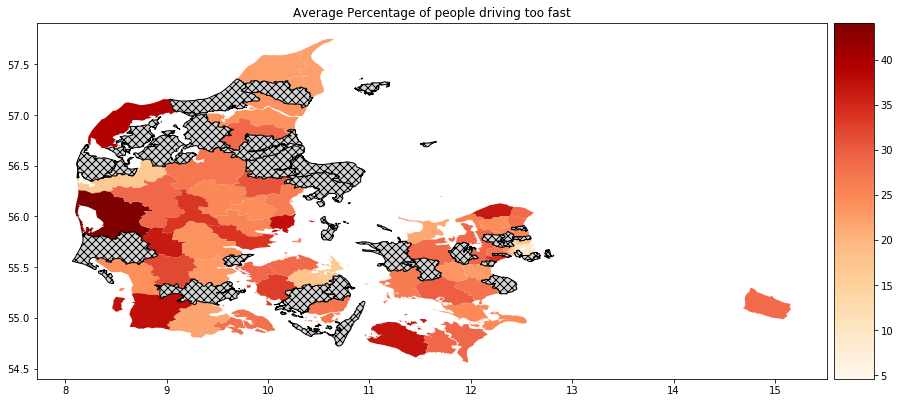

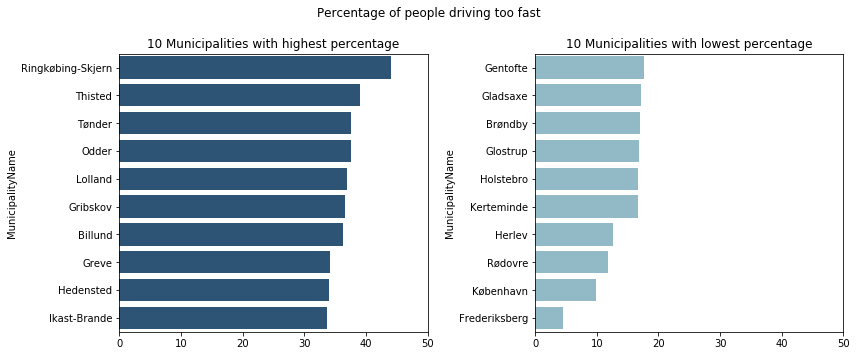

In [179]:
#Percentage of people driving too fast

df = traffic_data.groupby('MunicipalityName').PctOverSpeedLimit.mean().sort_values(ascending = False)

merged = pd.merge(dk, pd.DataFrame(df).reset_index(), how="outer")
fig, ax = plt.subplots(1,1, figsize=(15,10))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
ax.set_title(f"Average Percentage of people driving too fast")
merged.plot(column="PctOverSpeedLimit",
            ax=ax,
            legend=True,
            cax=cax,
            cmap='OrRd',
            missing_kwds={
            "color": "lightgrey",
            "edgecolor": "black",
            "hatch": "xxx",
            "label": "Missing values",
            })

plt.subplots(nrows=1, ncols=2, figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.title("10 Municipalities with highest percentage")
df1 = df.head(10)
ax = sns.barplot(df1.values, df1.keys(), order = df1.keys(), color="#215580")
ax.set(xlim=(0, 50))

plt.subplot(1, 2, 2)
plt.title("10 Municipalities with lowest percentage")
df2 = df.tail(10)
ax = sns.barplot(df2.values, df2.keys(), order = df2.keys(), color="#88bdcf")
ax.set(xlim=(0, 50))

plt.suptitle('Percentage of people driving too fast')
plt.tight_layout()
plt.subplots_adjust(top=0.85)

The four municipalities with the highest percentage of people driving above the speed limit are located in **Jutland**. On average, in those four municipalities, more than 35% of the people drive too fast.
Conversely, in **Frederiksberg** and **Copenhagen** less than 10% of people drive above the speed limit.

These differences might be due to several factors, such as the number of cars, the congestions, the police checks, the types of road, the presence of urban areas or countryside.


### Which municipalities register the highest/lowest percentage of people (among the fast drivers) driving +20km/h above the limit?
We then explore how the percentage of people driing +20km/h above the speed limit varies throughout the Danish municipalities.

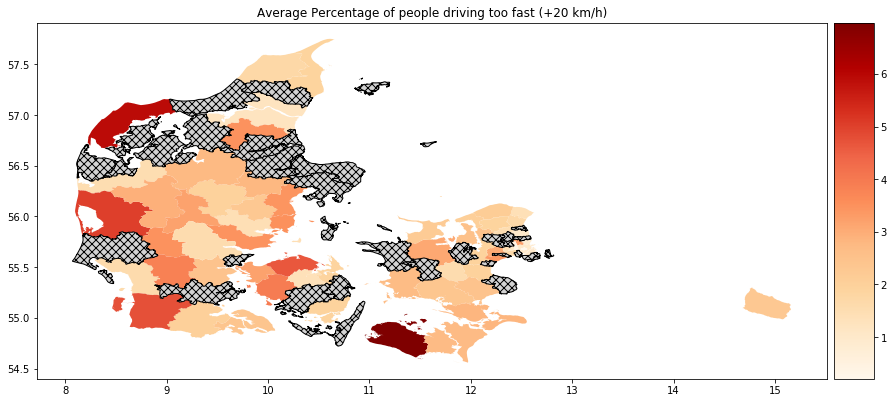

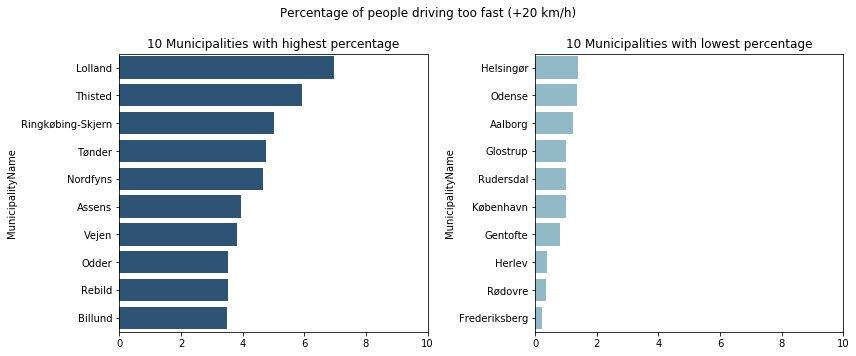

In [180]:
#Percentage of people driving too fast (+20 km/h)
df = traffic_data.groupby('MunicipalityName').PctOverSpeedLimit20.mean().sort_values(ascending = False)

merged = pd.merge(dk, pd.DataFrame(df).reset_index(), how="outer")
fig, ax = plt.subplots(1,1, figsize=(15,10))
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
ax.set_title(f"Average Percentage of people driving too fast (+20 km/h)")
merged.plot(column="PctOverSpeedLimit20",
            ax=ax,
            legend=True,
            cax=cax,
            cmap='OrRd',
            missing_kwds={
            "color": "lightgrey",
            "edgecolor": "black",
            "hatch": "xxx",
            "label": "Missing values",
            })

plt.subplots(nrows=1, ncols=2, figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.title("10 Municipalities with highest percentage")
df1 = traffic_data.groupby('MunicipalityName').PctOverSpeedLimit20.mean().sort_values(ascending = False).head(10)
ax = sns.barplot(df1.values, df1.keys(), order = df1.keys(), color="#215580")
ax.set(xlim=(0, 10))

plt.subplot(1, 2, 2)
plt.title("10 Municipalities with lowest percentage")
df2 = traffic_data.groupby('MunicipalityName').PctOverSpeedLimit20.mean().sort_values(ascending = False).tail(10)
ax = sns.barplot(df2.values, df2.keys(), order = df2.keys(), color="#88bdcf")
ax.set(xlim=(0, 10))

plt.suptitle('Percentage of people driving too fast (+20 km/h)')
plt.tight_layout()
plt.subplots_adjust(top=0.85)

**Lolland** and **Thisted** have the highest percentage of people driving +20km/h above the speed limit. The previous analysis showed that this type of offence is most likely to occur in roads with speed limits higher than 50km/h but lower than 130 km/h. These municipalities might have a higher proportion of these types of streets.

Consistently with the patterns seen above for the average speed and the percentage of people driving above the speed limit, the municipalities in **Copenhagen**'s area are the ones registering the lowest percentage of people driving +20km/h above the speed limit.

### Which roads register the highest percentage of "over the speed limit" drivers?

From our statistical description of the data features we noticed that PctOverSpeedLimit (the percentage over drivers over the speed limit) has a max value of 99.5%. This means that there is a road with that number. What is peculiar about this road? Are there others?

In [181]:
highestpctoverspeed = traffic_data[traffic_data.PctOverSpeedLimit > 99]
highestpctoverspeed

,FID,Dataowner,RoadManager,RoadId,RoadPartId,RoadName,Kilometer,Meter,Location,Municipality,TypeOfVehicle,Year,AverageDailyVehicles,AverageWeekdayDailyVehicles,DailyJulyTraffic,...,CountedDays,AverageDailyTrucks,SpeedLimit,Quantile15,Quantile85,PctOverSpeedLimit,PctOverSpeedLimit10,PctOverSpeedLimit20,PctOfTrucks,Coordinates,Longitude,Latitude,MunicipalityName,AverageDifferenceSpeedLimitAvgSpeed,JulyWeekdaysRatio
4732,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,50,3,Sønderjyske Motorvej,76.0,500.0,Slangetælling på rampe 3 <65>,621.0,MOTORKTJ,2014,1957.0,2257.0,1820.0,...,8.8,150.0,60.0,77.5,115.9,99.5,96.0,80.0,7.7,POINT (527879.0000003118 6146584.999745438),9.440935,55.46461797720619,Kolding,-35.0,0.806380
5321,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,52,1,Esbjergmotorvejen,228.0,0.0,KOMBISNIT ved TSA 64 Kolding V (2017),621.0,MOTORKTJ,2020,9301.0,9980.0,10118.0,...,93.0,729.0,60.0,72.4,96.9,99.1,90.3,68.5,7.8,POINT (527482.0000003082 6152118.99974534),9.435204,55.514365839668294,Kolding,-24.9,1.013828
15057,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,66,0,Herningmotorvejen,9.0,750.0,øst for frakørsler ved Køverbladet,751.0,MOTORKTJ,2020,26189.0,29487.0,27438.0,...,90.2,2063.0,80.0,97.9,125.2,99.4,93.7,82.7,7.9,POINT (565856.0000010033 6224165.999744008),10.060280,56.15794683592513,Aarhus,-30.8,0.930512


An interesting aspect that all the 3 roads share is that they all are highways (motorvej in danish). The speed limit is though lower than the one of a highway (usually greater than 100km/h): indeed the speed limits here are 80km/h and 60km/h. This can be explained by the description of the location: "frakørsler" and "rampe" indicate that this is the exit of the highway and hence explained the lower speed limit. Let's plot them on a map to get a visual confirmation.

In [182]:
map_obs = folium.Map(location=[56.2325, 10.7922], zoom_start = 7)
for index, row in highestpctoverspeed.iterrows():
    folium.Marker([row.Latitude, row.Longitude], popup=row.RoadName).add_to(map_obs)
map_obs

If we zoom on each point we can see that indeed the location is at the exit of a highway and this could explain the high number of drivers over the speed limit: the sudden change of speed limit from the highway one (over 100km/h) to a much lower one is what tricks many drivers. The high values for percentage of drivers over speed limit (also for +10km/h and +20km/h) may suggest that this change is to sudden and does not give enough visual notice or space for drivers to break and adjust their speed to the new speed limit.

By visually inspecting the road with highest value (Sønderjyske Motorvej, Kolding) with [google street view](https://www.google.com/maps/@55.4639892,9.4416129,3a,75y,321.24h,83.02t/data=!3m6!1e1!3m4!1sWmwzINIaT3ENcJ2eYp9lzA!2e0!7i13312!8i6656) we could not see a sign of a new speed limit when exiting the highway. This could hint to a lack of road signs being the cause of the high value!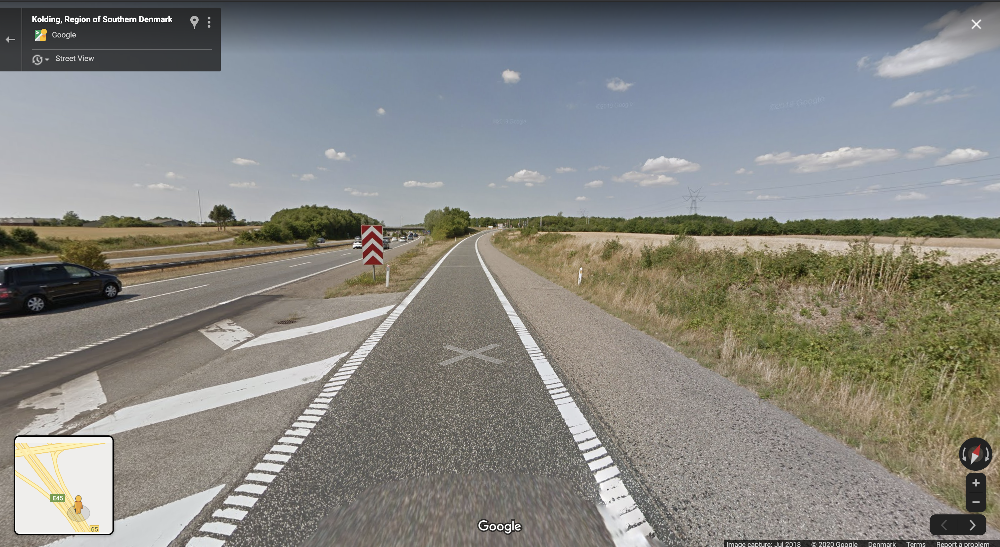

We now investigate if this is a national pattern: does highway exits present higher percentage of drivers driving over the speed limit - or are the three just analyzed an isolated case? 

We filter the observations containing "highway" in the name and having "ramp" or "exit" in their location description. We also filter on speed limits less than 100km/h to make sure that the measured spot is not at the entrance or on the highway, but at the exit of it and hence with a much lower speed limit. 

This filtering is not precise and we cannot be sure to include all the measurements of this type, but is a can be good first indiactor of whether there is a possible pattern in this type of connections.

In [183]:
#Plotting highway exits
roads = traffic_data[(traffic_data.RoadName.str.contains("motorvej", case=False)) 
                     & ((traffic_data.Location.str.contains("frakørsel", case=False)) 
                    | (traffic_data.Location.str.contains("rampe", case=False)))]
#Making sure it is an exit and not an entrance
roads = roads[roads.SpeedLimit < 100]
roads

,FID,Dataowner,RoadManager,RoadId,RoadPartId,RoadName,Kilometer,Meter,Location,Municipality,TypeOfVehicle,Year,AverageDailyVehicles,AverageWeekdayDailyVehicles,DailyJulyTraffic,...,CountedDays,AverageDailyTrucks,SpeedLimit,Quantile15,Quantile85,PctOverSpeedLimit,PctOverSpeedLimit10,PctOverSpeedLimit20,PctOfTrucks,Coordinates,Longitude,Latitude,MunicipalityName,AverageDifferenceSpeedLimitAvgSpeed,JulyWeekdaysRatio
148,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,0,0.0,40,4,Fynske Motorvej,172.0,785.0,ved frakørsel 53 ved ldv. 501,461.0,MOTORKTJ,2015,5221.0,5675.0,4840.0,...,7.0,221.0,70.0,49.0,81.9,46.0,17.5,4.0,4.2,POINT (576493.0000014836 6138679.999745573),10.207515,55.38841789958704,Odense,2.9,0.852863
2842,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153ca...,0,0.0,50,4,Sønderjyske Motorvej,23.0,0.0,ved frakørsel 71 ved ldv. 319,580.0,MOTORKTJ,2019,1441.0,1680.0,1772.0,...,81.4,271.0,80.0,73.9,95.8,68.7,30.3,8.2,18.8,POINT (523474.0000002594 6095048.999746415),9.366979,55.00175232619317,Aabenraa,-4.5,1.054762
4381,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,13,8,Hillerødmotorvejen,11.0,983.0,ved frakørsel 5 - Parallelvej Ring 4 - Vadstru...,159.0,MOTORKTJ,2020,1349.0,1697.0,1226.0,...,90.8,145.0,60.0,30.2,49.5,1.2,0.1,0.0,10.7,POINT (715978.0009624183 6184579.999757524),12.442310,55.75859992264074,Gladsaxe,18.7,0.722451
4732,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,50,3,Sønderjyske Motorvej,76.0,500.0,Slangetælling på rampe 3 <65>,621.0,MOTORKTJ,2014,1957.0,2257.0,1820.0,...,8.8,150.0,60.0,77.5,115.9,99.5,96.0,80.0,7.7,POINT (527879.0000003118 6146584.999745438),9.440935,55.46461797720619,Kolding,-35.0,0.806380
7666,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,14,3,Helsingørmotorvejen,36.0,850.0,Frakørsel til Lyngbyvej,157.0,MOTORKTJ,2020,2372.0,2757.0,1946.0,...,92.9,NaN,80.0,70.4,94.7,56.8,23.0,6.1,NaN,POINT (720901.0011260674 6184389.99976095),12.520456,55.75467537494904,Gentofte,-1.6,0.705840
8119,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,40,3,Fynske Motorvej,172.0,485.0,ved frakørsel 53 ved ldv. 501,461.0,MOTORKTJ,2015,1896.0,2228.0,1757.0,...,8.0,80.0,70.0,58.0,80.9,48.3,16.5,3.8,4.2,POINT (576927.0000015119 6138607.99974557),10.214345,55.38770323320428,Odense,0.5,0.788600
8120,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,40,5,Fynske Motorvej,172.0,465.0,ved frakørsel 53 ved ldv. 501,461.0,MOTORKTJ,2015,5521.0,6191.0,5114.0,...,8.0,233.0,70.0,71.5,92.4,89.7,53.6,19.2,4.2,POINT (576839.0000015064 6138681.999745564),10.212976,55.38838182109768,Odense,-12.3,0.826038
8121,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,40,6,Fynske Motorvej,172.0,695.0,ved frakørsel 53 ved ldv. 501,461.0,MOTORKTJ,2015,2613.0,3019.0,2421.0,...,8.0,216.0,70.0,56.3,74.8,28.3,8.2,3.6,8.3,POINT (576696.0000014992 6138544.999745572),10.210682,55.38717340172707,Odense,4.0,0.801921
9153,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,64,8,Midtjyske Motorvej,12.0,800.0,KOMBISNIT Frakørsel fra vest (2013),766.0,MOTORKTJ,2020,4852.0,5210.0,5278.0,...,93.0,408.0,90.0,85.3,119.8,75.9,57.4,32.3,8.4,POINT (531020.0000003504 6187530.999744683),9.495232,55.832334061913436,Hedensted,-13.0,1.013052
9420,OPEN_DATA_NOEGLETAL_VIEW.fid--1778853a_17153cf...,0,0.0,64,3,Midtjyske Motorvej,13.0,700.0,Frakørsel fra Horsens til Tørringvej (2013),630.0,MOTORKTJ,2020,607.0,655.0,660.0,...,93.0,31.0,90.0,77.6,99.8,43.9,14.5,3.9,5.1,POINT (530120.0000003405 6187571.9997446835),9.480869,55.832759434443425,Vejle,0.9,1.007634


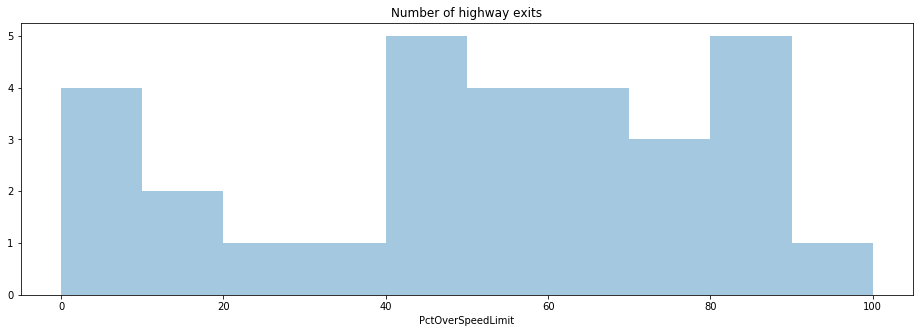

In [184]:
plt.figure(figsize=(16,5))
plt.title("Number of highway exits")
ax = sns.distplot(roads.PctOverSpeedLimit,bins=[0,10,20,30,40,50,60,70,80,90,100],kde=False)

There does seem to be a general trend affecting highway exits. 

Indeed the median for PctOverSpeedLimit over all roads is 17.5 and it is 59.9 for the selected highway exists.

In [185]:
roads.PctOverSpeedLimit.median()

59.9

In [186]:
traffic_data.PctOverSpeedLimit.median()

17.5

## 2. Socioeconomic data set

The following dataset contains socioeconomic factors (Nøgletal, in danish) for all the danish municipalities through the years from 2010 to 2020. The dataset has been obtained by selecting a subset of all the available factors [here](http://noegletal.dk/noegletal/).

### Data loading and cleaning

In [187]:
url = 'https://raw.githubusercontent.com/IncioMan/socialdata/master/FinalProject/dataset/kommunedata_processed.csv'
kommune_data = pd.read_csv(url, encoding = "ISO-8859-1")
kommune_data

,KommuneNr,IndicatorType,Year,Value,KommuneName
0,101,Indbyggertal 1. januar,2010,528208.0,Københavns Kommune
1,101,Indbyggertal 1. januar,2011,539542.0,Københavns Kommune
2,101,Indbyggertal 1. januar,2012,549050.0,Københavns Kommune
3,101,Indbyggertal 1. januar,2013,559440.0,Københavns Kommune
4,101,Indbyggertal 1. januar,2014,569557.0,Københavns Kommune
...,...,...,...,...,...
19399,860,Gennemsnitlig skolestørrelse,2016,880.0,Hjørring Kommune
19400,860,Gennemsnitlig skolestørrelse,2017,850.0,Hjørring Kommune
19401,860,Gennemsnitlig skolestørrelse,2018,820.0,Hjørring Kommune
19402,860,Gennemsnitlig skolestørrelse,2019,804.0,Hjørring Kommune


In [188]:
kommune_data.shape

(19404, 5)

The dataset contains 19404 observations, and 5 features. One of these features is the IndicatorType, which specifies the type of factor reported in the observation.

#### Available factors

In [189]:
english_factors = {'Indbyggertal 1. januar':'Population_size_1_January',
'Andel 0-17-årige': 'Percentage_0-17-years',
'Andel 18-66-årige': 'Percentage_18-66-years',
'Andel 65+-årige': 'Percentage_65+-years',
'Befolkningstæthed (indb/km2)': "Population_density_(inhab/km2)",
'Andel udpendlere': "Percentage_outgoing_commuters",
'Andel indpendlere': "Percentage_ingoing_commuters",
'Andel 25-64-årige med videregående uddannelse': "Percentage_25-64-years_with_higher_education",
'Fuldtidsledige pr. 100 17-64/66-årige': "Unemployed_pr100_17-64/66-years",
'Statsborgere fra vestlige lande pr. 10.000 indb.': "Citizens_from_western_countries_pr10000",
'Statsborgere fra ikke-vestlige lande pr. 10.000 indb.': "Citizens_not_from_western_countries_pr10000",
'Anmeldte tyverier/indbrud pr. 1.000 indb.': "Reported_thefts_break-ins_pr_1000",
'Anmeldte voldsforbrydelser pr. 1.000 indb.': "Reported_violent_crimes_pr_1000",
'Socioøkonomisk indeks': "Socioeconomic_factor",
'Udg. til byudvikling, bolig og miljø pr. indb.': "Expenses_for_city_development_residential_environment_pr_citizen",
'Udg. til transport og infrastruktur pr. indb.': "Expenses_for_transportation_and_infrastructure_pr_citizen",
'Antal folkeskoler': "Number_of_primary_schools",
'Gennemsnitlig skolestørrelse': "Average_size_schools"}

In [190]:
#convert names to the english versions
kommune_data = kommune_data.replace({"IndicatorType": english_factors})

In [191]:
kommune_data.IndicatorType.unique()

array(['Population_size_1_January', 'Percentage_0-17-years',
       'Percentage_18-66-years', 'Percentage_65+-years',
       'Population_density_(inhab/km2)', 'Percentage_outgoing_commuters',
       'Percentage_ingoing_commuters',
       'Percentage_25-64-years_with_higher_education',
       'Unemployed_pr100_17-64/66-years',
       'Citizens_from_western_countries_pr10000',
       'Citizens_not_from_western_countries_pr10000',
       'Reported_thefts_break-ins_pr_1000',
       'Reported_violent_crimes_pr_1000', 'Socioeconomic_factor',
       'Expenses_for_city_development_residential_environment_pr_citizen',
       'Expenses_for_transportation_and_infrastructure_pr_citizen',
       'Number_of_primary_schools', 'Average_size_schools'], dtype=object)

A brief summary of the available factors along with a description for each of them:

| Factor                                                           | Description |
|------------------------------------------------------------------|-------------|
| Population_size_1_January                                        | Number of inhabitants in the municipality on the 1st of January.          |
| Percentage_0-17-years                                            |  Number of 0-17 year olds as a percentage of the number of inhabitants in the municipality on the 1st of January     |
| Percentage_18-66-years                                           |  Number of 18-66 year olds as a percentage of the number of inhabitants in the municipality on the 1st of January           |
| Percentage_65+-years                                             |  Number of inhabitants aged 65 and over as a percentage of the number of inhabitants in the municipality on the 1st of January.           |
| Population_density_(inhab/km2)                                    | Number of inhabitants per km2 on the 1st of January           |
| Percentage_outgoing_commuters                                    |   Number of people employed in another municipality as a percentage of the number of employed people residing in the municipality per 1st of January.          |
| Percentage_ingoing_commuters                                     |   Number of people with a place of work in the municipality, but domiciled in another municipality as a percentage of people with a place of work in the municipality per year on the 1st of January.          |
| Percentage_25-64-years_with_higher_education                     |   Number of 25-64 year olds with a higher education in relation to the total number of 25-64 year olds in the municipality.          |
| Unemployed_pr100_17-64/66-years                                  |  Average number of full-time unemployed in the municipality per 100 17-64 year olds. Unemployment is defined as gross unemployment, which is defined as the sum of the registered (net) unemployed and those who are at the same time considered to be job ready.
The population is calculated per. January 1 of the year.           |
| Citizens_from_western_countries_pr10000                          |  Number of people with citizenship from Western countries per 10,000 inhabitants per 1st of January.  Western countries include EU countries plus Andorra, Iceland, Liechtenstein, Monaco, Norway, San Marino, Switzerland, Vatican City, Canada, USA, Australia and New Zealand.  |
| Citizens_not_from_western_countries_pr10000                      |   Number of people with citizenship from non-western countries per 10,000 inhabitants per 1st of January.          |
| Reported_thefts_break-ins_pr_1000                                |   Number of police reported thefts, including car theft, motorcycle / moped and bicycles as well as burglary. 1,000 inhabitants per 1st of January. The violations include burglary in the bank, shops, villas, apartments, holiday homes, garages, etc., car theft, boat, shop theft and other thefts, as well as theft and use theft of registered vehicles, mopeds and bicycles.          |
| Reported_violent_crimes_pr_1000                                  |     Number of police reported crimes against private individuals per 1,000 inhabitants per 1st of January.        |
| Socioeconomic_factor                                             |  The key figure measures the municipality's relative expenditure needs in relation to other municipalities on the basis of a number of socio-economic criteria. There are criteria such as 'Number of 20-59 year-olds without employment' and 'Number of psychiatric patients'. The precise definition can be found in the Ministry of Social Affairs and the Ministry's publication 'Municipal Equalization and General Grants 2008', page 40. A value above 1 means that the municipality has a greater need for expenditure relative to the average of the municipalities, while a value lower than 1 means a lower spending needs relative to the average.     |
| Expenses_for_city_development_residential_environment_pr_citizen |   Net operating expenses (DKK) in main account that covers the areas of land supply, real estate, recreation areas, leisure facilities, cemeteries, nature protection, waterways, environmental protection, etc. and emergency preparedness.         |
| Expenses_for_transportation_and_infrastructure_pr_citizen         |   Net operating expenses (DKK) per inhabitant in the account that covers the areas of municipal roads, public transport and ports. Data up to and including 2018 are accounting figures, while information thereafter is budget figures. The population is calculated per. January 1 of the year.     |
| Number_of_primary_schools                                        |    The number of primary schools is calculated as the average for the two school years included in the calendar year. For the past school year, this is an expected number.          |
| Average_size_schools                                             |   The number of normal class pupils from kindergarten to 10th grade divided by the number of primary schools calculated as the average for the two school years included in the calendar year. For the past school year, this is an expected number.    |

### NaN Values

The dataset does not present Nan values

In [192]:
kommune_data.isna().sum()

KommuneNr        0
IndicatorType    0
Year             0
Value            0
KommuneName      0
dtype: int64

### Number of municipalities

In [193]:
len(kommune_data.KommuneNr.unique())

98

In [194]:
len(kommune_data.KommuneName.unique())

98

As expect, we have data for all the 98 danish municipalities.

### Summary statistics and variable distribution

In [195]:
kommune_data.describe()

,KommuneNr,Year,Value
count,19404.000000,19404.000000,19404.000000
mean,462.173469,2015.000000,3477.919301
std,235.351491,3.162359,20811.227583
min,101.000000,2010.000000,-525.000000
25%,240.000000,2012.000000,14.000000
50%,435.000000,2015.000000,44.700000
75%,706.000000,2018.000000,351.000000
max,860.000000,2020.000000,632340.000000


From this statistical summary we can notice that the **Year** feature does not present outliers. All the values for Year lie in the range 2010-2020 as expected. For analyzing the statistical summaries for the factors, we need to groupby their value.

In [196]:
kommune_data.groupby(kommune_data.IndicatorType)["Value"].describe()

,count,mean,std,min,25%,50%,75%,max
IndicatorType,,,,,,,,
Average_size_schools,1078.0,455.296846,284.421433,-1.00,302.000,409.50,590.000,2126.00
Citizens_from_western_countries_pr10000,1078.0,311.810761,137.189556,108.00,208.250,284.00,378.000,1014.00
Citizens_not_from_western_countries_pr10000,1078.0,343.367347,197.235967,20.00,216.000,308.00,394.750,1493.00
Expenses_for_city_development_residential_environment_pr_citizen,1078.0,875.750464,542.538264,-80.00,491.500,758.50,1110.500,4106.00
Expenses_for_transportation_and_infrastructure_pr_citizen,1078.0,1861.199443,1581.005225,-525.00,1418.250,1645.50,1910.750,20176.00
Number_of_primary_schools,1078.0,11.333488,10.450301,-1.00,4.000,9.00,15.500,60.50
Percentage_0-17-years,1078.0,21.203711,2.337273,12.50,20.000,21.50,22.700,26.90
Percentage_18-66-years,1078.0,60.967532,2.727855,51.10,59.525,60.90,62.100,73.80
Percentage_25-64-years_with_higher_education,1078.0,23.434230,11.827535,-1.00,18.600,22.50,27.700,59.80


All factors present the same number of observations. We can notice that some factors have -1 as minimum value. Factors such as **Unemployed** or **Percentages** should not be allowed to have negative values. It is likely that -1 is used as replacement for missing values. However factors such as **Expenses_for_city_development_residential_environment_pr_citizen** and **Expenses_for_transportatio_and_infrastructure_pr_citizen** do have a minimum values which are not simply -1 but instead, few observations present different negative values. 

In [197]:
kommune_data[kommune_data.IndicatorType.str.contains("Expenses") & (kommune_data.Value < 0)]

,KommuneNr,IndicatorType,Year,Value,KommuneName
15545,350,Expenses_for_city_development_residential_envi...,2012,-71.0,Lejre Kommune
15546,350,Expenses_for_city_development_residential_envi...,2013,-32.0,Lejre Kommune
15984,751,Expenses_for_city_development_residential_envi...,2011,-17.0,Aarhus Kommune
15985,751,Expenses_for_city_development_residential_envi...,2012,-37.0,Aarhus Kommune
16064,787,Expenses_for_city_development_residential_envi...,2014,-80.0,Thisted Kommune
17046,741,Expenses_for_transportation_and_infrastructure...,2017,-525.0,Samsø Kommune


Investigating further the description of these factors, it turns out that these represent netto figures. Even though it is not common, it may be that these municipalities have earned more than what they have invested in those sectors that year. We therefore decided to keep these values as they do not seem to represent mistakes in the data. 

In [198]:
#removing negative values
kommune_data = kommune_data[(kommune_data.IndicatorType.str.contains("Expenses") | (kommune_data.Value > 0))]

In [199]:
kommune_data.shape

(18322, 5)

By removing the negative value obervations, we reduced the dataset by around 1000 observations.

In [200]:
kommune_data.groupby(kommune_data.IndicatorType)["Value"].describe()

,count,mean,std,min,25%,50%,75%,max
IndicatorType,,,,,,,,
Average_size_schools,980.0,500.926531,257.035458,141.00,335.750,434.00,606.250,2126.00
Citizens_from_western_countries_pr10000,1078.0,311.810761,137.189556,108.00,208.250,284.00,378.000,1014.00
Citizens_not_from_western_countries_pr10000,1078.0,343.367347,197.235967,20.00,216.000,308.00,394.750,1493.00
Expenses_for_city_development_residential_environment_pr_citizen,1078.0,875.750464,542.538264,-80.00,491.500,758.50,1110.500,4106.00
Expenses_for_transportation_and_infrastructure_pr_citizen,1078.0,1861.199443,1581.005225,-525.00,1418.250,1645.50,1910.750,20176.00
Number_of_primary_schools,980.0,12.566837,10.168141,1.00,6.000,10.00,16.125,60.50
Percentage_0-17-years,1078.0,21.203711,2.337273,12.50,20.000,21.50,22.700,26.90
Percentage_18-66-years,1078.0,60.967532,2.727855,51.10,59.525,60.90,62.100,73.80
Percentage_25-64-years_with_higher_education,980.0,25.877653,9.389002,13.70,19.800,23.10,28.400,59.80


### Distribution over the years

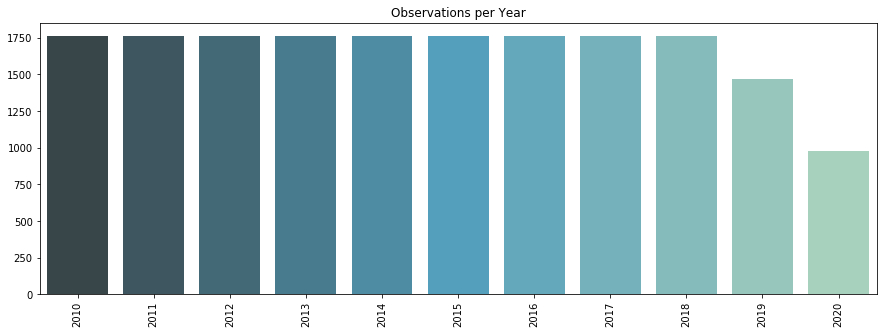

In [201]:
plt.figure(figsize=(15,5))
plt.title("Observations per Year")
df = kommune_data.Year.value_counts()
ax = sns.barplot(df.keys(), df.values, order=df.keys().sort_values(), palette="GnBu_d")
plt.setp(ax.get_xticklabels(), rotation=90);

## 3. Correlations between driving behavior and socioeconomic data

## 4. Explaining the driving behavior based on socioeconomic data

## 5. KNN-prediction

# Appendix

### Comparison among focus-municipalities

#### Selection of focus municipalities

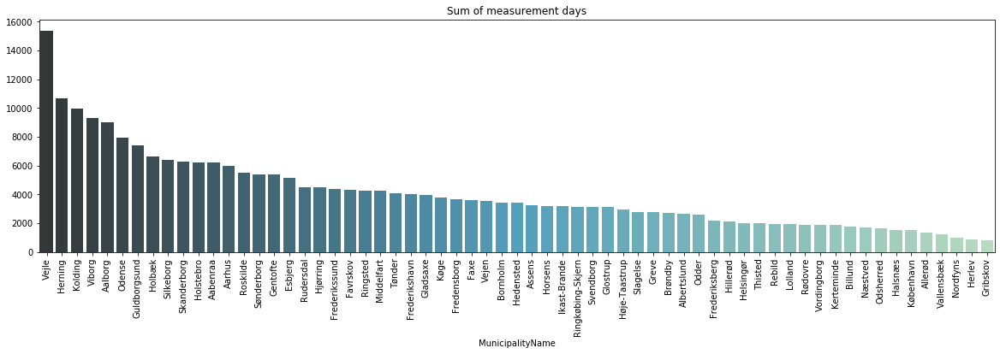

In [202]:
plt.figure(figsize=(20,5))
plt.title("Sum of measurement days")
df = traffic_data.groupby('MunicipalityName').CountedDays.sum().sort_values(ascending = False)
ax = sns.barplot(df.keys(), df.values, order = df.keys(), palette="GnBu_d")
plt.setp(ax.get_xticklabels(), rotation=90);

In [203]:
base = 3
traffic_data["CountedDaysLog"]= np.log(traffic_data.CountedDays+1) / np.log(base)

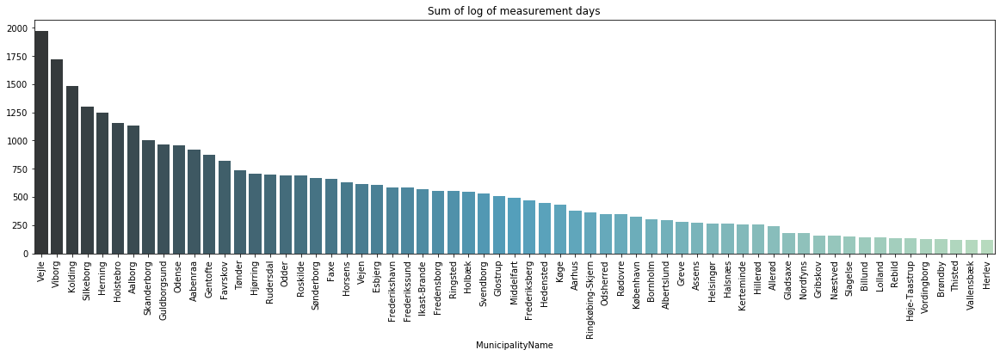

In [204]:
plt.figure(figsize=(20,5))
plt.title("Sum of log of measurement days")
df = traffic_data.groupby('MunicipalityName').CountedDaysLog.sum().sort_values(ascending = False)
ax = sns.barplot(df.keys(), df.values, order = df.keys(), palette="GnBu_d")
plt.setp(ax.get_xticklabels(), rotation=90);

In [205]:
focusmunicipalitiessize = 13
mostcountedlog = traffic_data.groupby('MunicipalityName').CountedDaysLog.sum().sort_values(ascending = False)
mostcounted = traffic_data.groupby('MunicipalityName').CountedDays.sum().sort_values(ascending = False)
newmun = (set(mostcountedlog[:focusmunicipalitiessize].index) - set(mostcounted[:focusmunicipalitiessize].index))
lostmun = (set(mostcounted[:focusmunicipalitiessize].index) - set(mostcountedlog[:focusmunicipalitiessize].index))

In [206]:
lostmun

{'Aarhus', 'Holbæk'}

In [207]:
newmun

{'Favrskov', 'Gentofte'}

In [208]:
mostcountedlog

MunicipalityName
Vejle          1974.797059
Viborg         1718.130900
Kolding        1482.235755
Silkeborg      1302.713300
Herning        1249.691214
                  ...     
Vordingborg     128.844771
Brøndby         124.994977
Thisted         116.628921
Vallensbæk      115.151927
Herlev          114.976813
Name: CountedDaysLog, Length: 63, dtype: float64

In [209]:
focusmunicipalities = mostcountedlog[:focusmunicipalitiessize].index
# Add Copenhagen because it is the capital
focusmunicipalities = list(focusmunicipalities)
focusmunicipalities.append("København")

In [210]:
focusmunicipalities

['Vejle',
 'Viborg',
 'Kolding',
 'Silkeborg',
 'Herning',
 'Holstebro',
 'Aalborg',
 'Skanderborg',
 'Guldborgsund',
 'Odense',
 'Aabenraa',
 'Gentofte',
 'Favrskov',
 'København']

#### Plot variables against focus municipalities

In [211]:
data_to_focus = traffic_data[traffic_data.MunicipalityName.isin(focusmunicipalities)]
data_to_focus = data_to_focus[data_to_focus.Year > 2012]

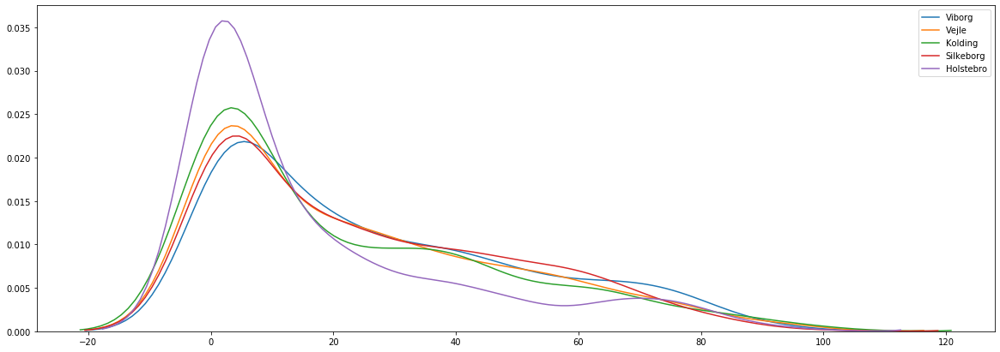

In [212]:
#Work in progress (to compare the distribution of more municipalities in only one chart)
plt.figure(figsize=(20,7))
for i in data_to_focus.MunicipalityName.value_counts().head(5).keys():
    sns.kdeplot(data_to_focus[data_to_focus.MunicipalityName == i]["PctOverSpeedLimit"], label= i )

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x1a49120f50>,
      dtype=object)

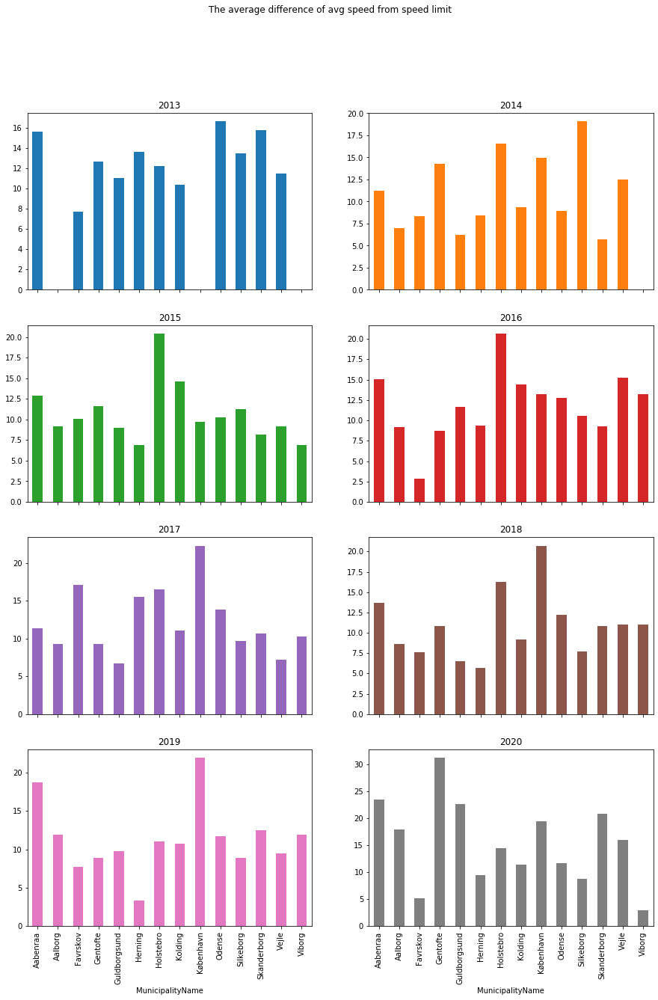

In [213]:
focus_counth =data_to_focus.groupby(['MunicipalityName', 'Year'])['AverageDifferenceSpeedLimitAvgSpeed'].mean()
focus_counth.unstack().plot.bar(subplots=True,layout=(4,2), figsize=(15,20), legend=False, title='The average difference of avg speed from speed limit')

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x1a46b09210>,
      dtype=object)

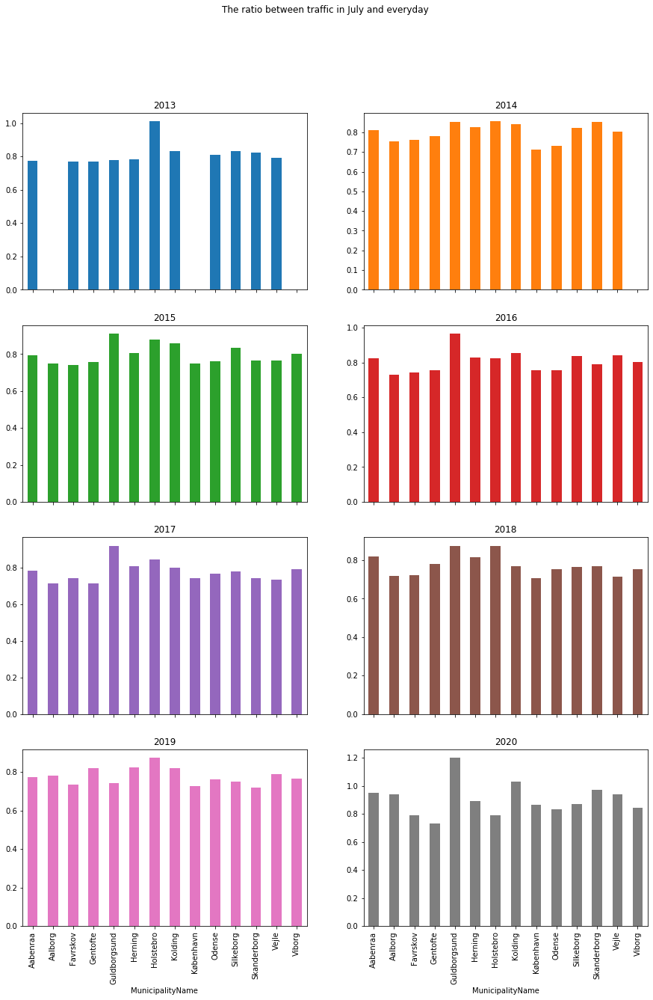

In [214]:
focus_counth =data_to_focus.groupby(['MunicipalityName', 'Year'])['JulyWeekdaysRatio'].mean()
focus_counth.unstack().plot.bar(subplots=True,layout=(4,2), figsize=(15,20), legend=False, title='The ratio between traffic in July and everyday')

Tonder and Koling seem to have an increase!

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x1a46017410>,
      dtype=object)

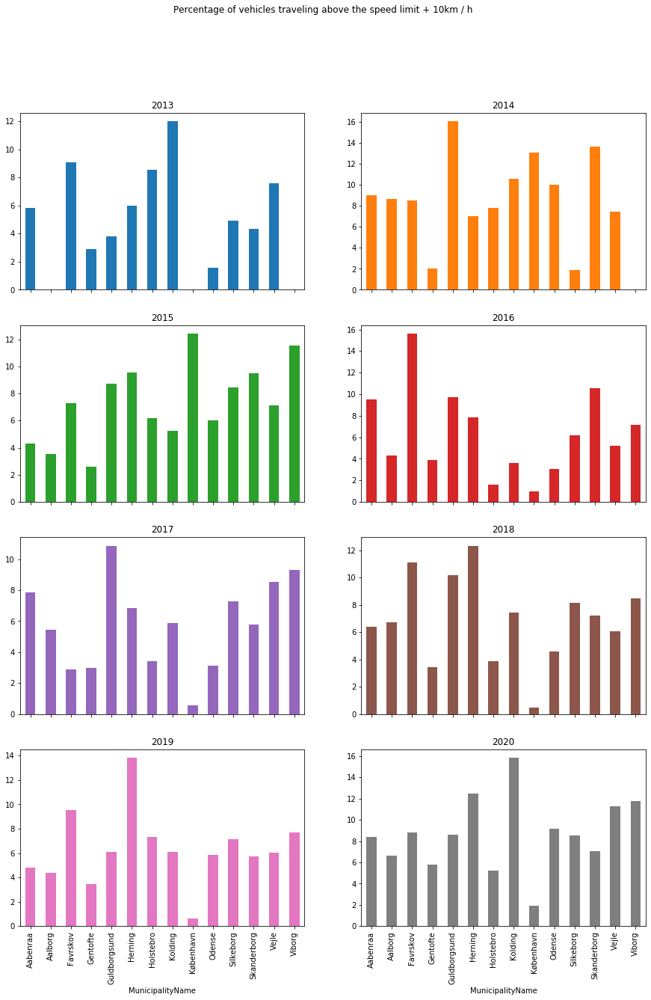

In [215]:
focus_counth =data_to_focus.groupby(['MunicipalityName', 'Year'])['PctOverSpeedLimit10'].mean()
focus_counth.unstack().plot.bar(subplots=True,layout=(4,2), figsize=(15,20), legend=False, title='Percentage of vehicles traveling above the speed limit + 10km / h')

### Plot focusmunicipaliy variables

In [216]:
data_to_focus = data_to_focus.reset_index(drop=True)

In [217]:
continuous = ['Kilometer', 'Meter',
       'Year', 'AverageDailyVehicles', 'AverageWeekdayDailyVehicles',
       'DailyJulyTraffic', 'AverageSpeed', 'CountedDays',
       'AverageDailyTrucks', 'SpeedLimit', 'Quantile15', 'Quantile85',
       'PctOverSpeedLimit', 'PctOverSpeedLimit10', 'PctOverSpeedLimit20',
       'PctOfTrucks', 'AverageDifferenceSpeedLimitAvgSpeed',
       'JulyWeekdaysRatio']

categories = ['Traffictype','SpeedLimit']

In [218]:
len(continuous)

18

Let's compare the continuous variables for the focus-municipalities.

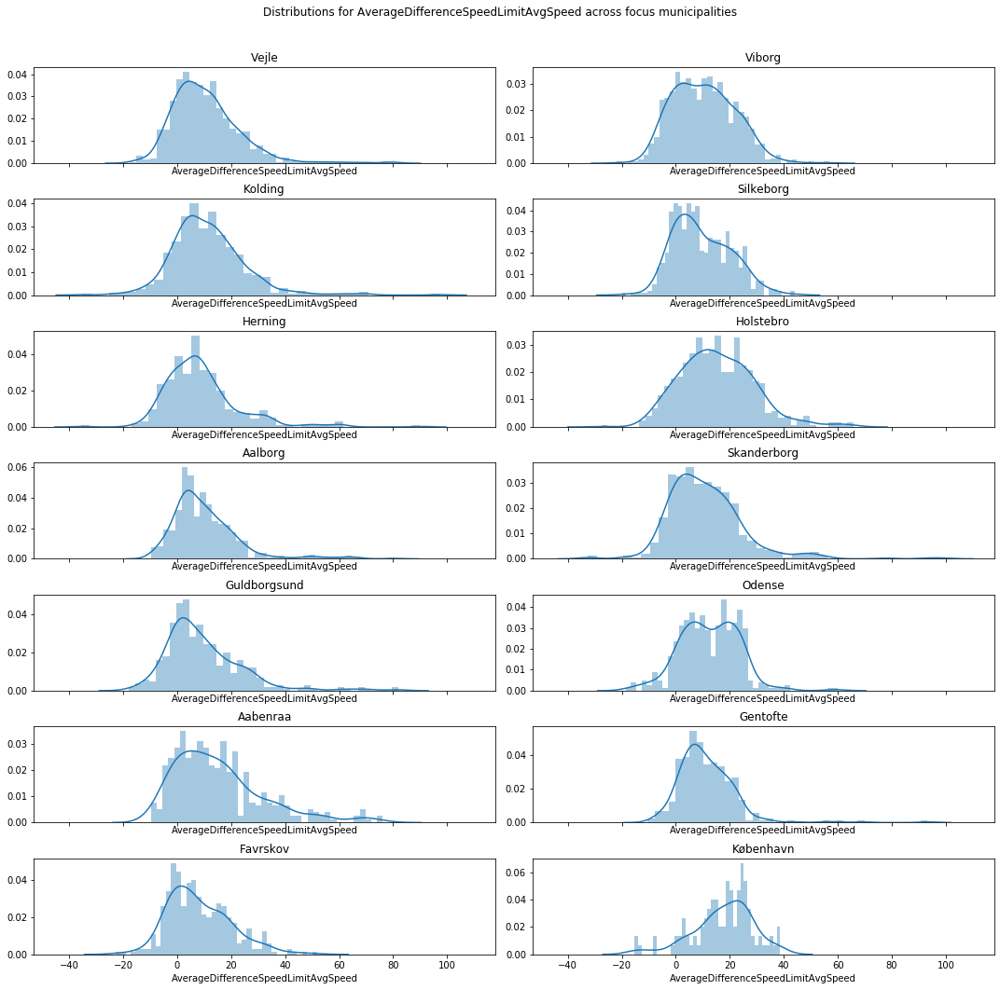

In [219]:
k = 16
f, axes = plt.subplots(7, 2, figsize=(15, 15), sharex=True)
i = 0
for fm in focusmunicipalities:
    sns.distplot((pd.to_numeric(data_to_focus[data_to_focus["MunicipalityName"] == fm][continuous[k]])), ax=axes[i // 2, i % 2], bins = 40).set_title(fm)
    #ax.title(fm)
    f.tight_layout()
    #axes[i // 2, i % 2].set_xlim([0, 20]) # Xlimits for some plots that have very long tails
    i+=1
    
f.subplots_adjust(top=0.92)
f.suptitle('Distributions for {} across focus municipalities'.format(continuous[k]))

f.show()

By changing the value k you can change the variable which is compared.
By choosing k = 6 the Average Speed is plotted for the municipalities. Doing this reveals that København has a much lower average speed compared to places such as Tønder and Viborg.

By choosing the PctOverSpeedLimit20 (k = 14) it is noted that municipalities such as Tønder and Viborg have a large amount of drivers who are driving much faster than the speed limit, compared to for example København and Vejle.

Looking at the previously constructed AverageSpeedToSpeedLimit (k = 16) variable we see that for the majority of the municipalities, the danes are driving slower than the speeding limit, however the speeding limit is exceeded by some drivers. 

In [220]:
# Personal favorites (Jonas) k= 3,6,9,10,11,16

Let's look at the categorical data across the focus municipalities.

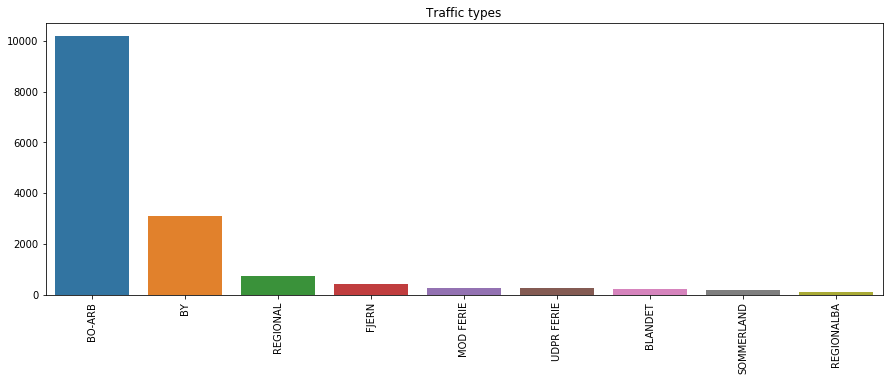

In [221]:
plt.figure(figsize=(15,5))
plt.title("Traffic types")
df = traffic_data.Traffictype.value_counts()
ax = sns.barplot(df.keys(), df.values)
plt.setp(ax.get_xticklabels(), rotation=90);

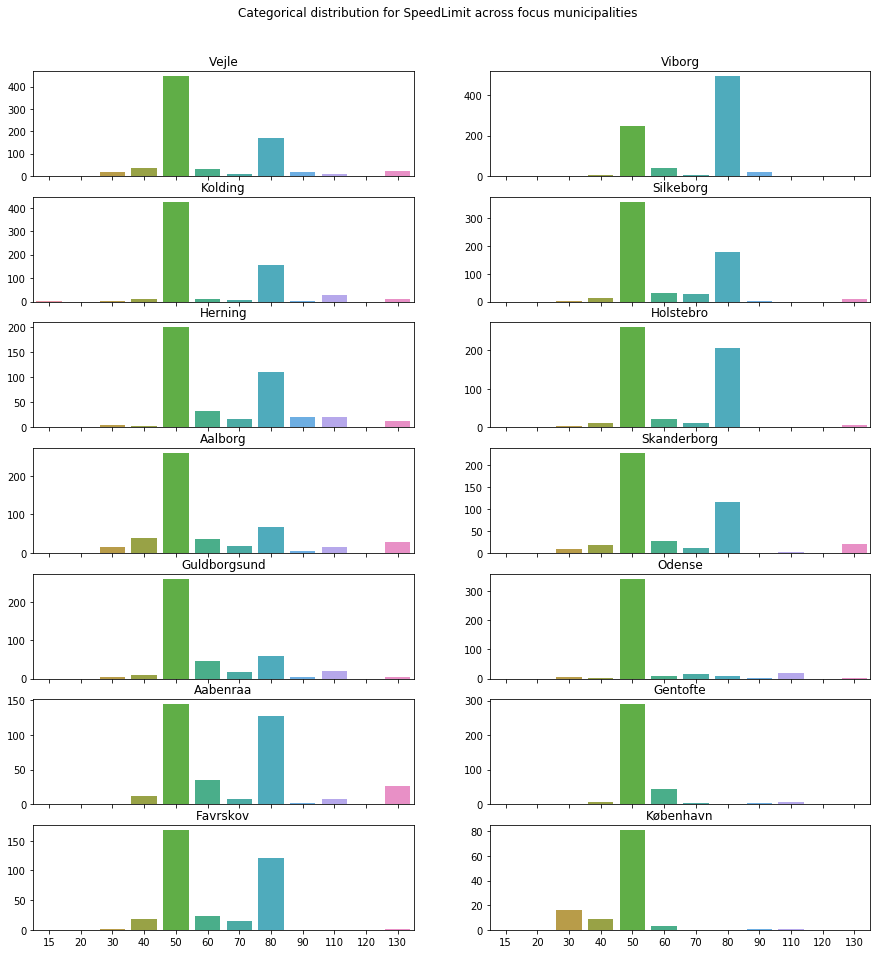

In [222]:
k = 1
f, axes = plt.subplots(7, 2, figsize=(15, 15), sharex=True, sharey = False)
i = 0 


for fm in focusmunicipalities:
    vals = []
    possiblespeeds = data_to_focus[categories[k]].value_counts().keys()
    
    df = data_to_focus[data_to_focus["MunicipalityName"] == fm][categories[k]]
    
    for j in range(len(possiblespeeds)):
        vals.append(sum(df == possiblespeeds[j]))
    
    sns.barplot(possiblespeeds.astype(np.int), vals, ax = axes[i // 2, i % 2]).set_title(fm)
    #plt.setp(ax.get_xticklabels(), rotation=90);   
    i+=1
    
f.subplots_adjust(top=0.92)
f.suptitle('Categorical distribution for {} across focus municipalities'.format(categories[k]))
f.show()

Looking at the SpeedLimit variable it is noticed that 50 is the most common speed limit across the roads in the focus municipalities. It is also noted that some municipalities have many high speed roads, while some have almost none. For exampel Gentofte has almost no high speed roads, as this is also a city with no high-way while Aabenraa has a lot more high speed roads.

#### Traffic types 


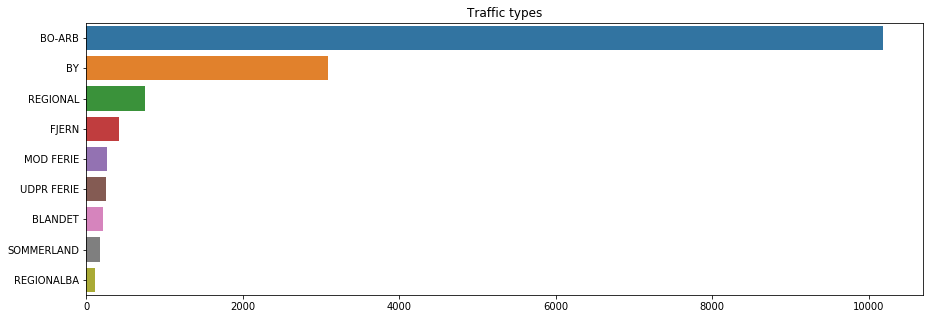

In [223]:
plt.figure(figsize=(15,5))
plt.title("Traffic types")
df = traffic_data.Traffictype.value_counts()
ax = sns.barplot(df.values, df.keys())

In [224]:
df3 = traffic_data.groupby('MunicipalityName')
df4 = pd.DataFrame(df3.AverageSpeed.mean())
df4["AverageDailyVehicles"] = pd.DataFrame(df3.AverageDailyVehicles.mean())
df4["PctOverSpeedLimit"] = pd.DataFrame(df3.PctOverSpeedLimit.mean())
df4["PctOverSpeedLimit20"] = pd.DataFrame(df3.PctOverSpeedLimit20.mean())

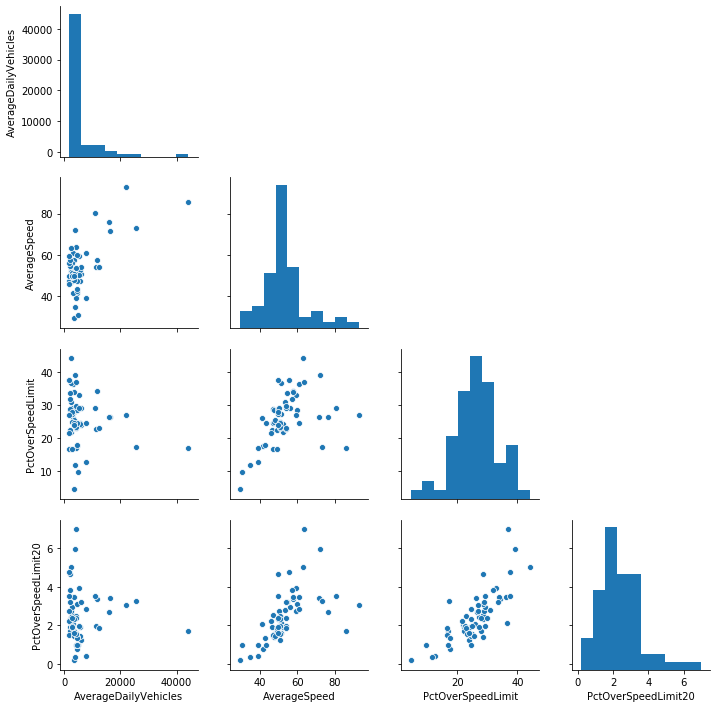

In [225]:
def hide_current_axis(*args, **kwds):
    plt.gca().set_visible(False)

g = sns.pairplot(df4, vars = ['AverageDailyVehicles', 'AverageSpeed', 'PctOverSpeedLimit', "PctOverSpeedLimit20"] )

g.map_upper(hide_current_axis)


### KNN-prediction

In [226]:
Xdata = traffic_data[["Longitude","Latitude"]]
Xdata["Latitude"] = Xdata["Latitude"].str.replace(';','')

Xdata = Xdata.astype("float64")
ydata = pd.to_numeric(traffic_data["AverageDifferenceSpeedLimitAvgSpeed"], downcast='float')

In [227]:
knn = KNeighborsRegressor(n_neighbors = 10)
knn.fit(Xdata.values, ydata.values)

KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=None, n_neighbors=10, p=2,
                    weights='uniform')

In [228]:
longrid = np.linspace(7.5018, 12.5018, 100)
latgrid = np.linspace(53.2639 , 57.7639, 100)

In [229]:
preds = knn.predict(Xdata)

In [230]:
colorscale = branca.colormap.linear.RdPu_09.scale(min(preds), max(preds))
colorscale

In [231]:
denmark = folium.Map([56.2639,9.5018], zoom_start=7)


# KNN scatter plot
for i in range(0,len(longrid)):
    for j in range(0,len(latgrid)):
        
        pred = knn.predict([[longrid[i],latgrid[j]]])[0]
        
        folium.CircleMarker(location=[latgrid[j],longrid[i]],
                                radius=0.8,
                                weight=2, color = colorscale(pred)).add_to(denmark)
        
colorscale.caption = 'Average speed to speed limit'
denmark.add_child(colorscale)

In [232]:
'''
denmark2 = folium.Map([56.2639,9.5018], zoom_start=7)


# KNN scatter plot
for i in range(0,len(longrid)):
    for j in range(0,len(latgrid)):
        
        pred = knn.predict([[longrid[i],latgrid[j]]])[0]
        
        folium.Marker(location=[latgrid[j],longrid[i]],
                                color = colorscale(pred)).add_to(denmark2)
        
'''

'\ndenmark2 = folium.Map([56.2639,9.5018], zoom_start=7)\n\n\n# KNN scatter plot\nfor i in range(0,len(longrid)):\n    for j in range(0,len(latgrid)):\n        \n        pred = knn.predict([[longrid[i],latgrid[j]]])[0]\n        \n        folium.Marker(location=[latgrid[j],longrid[i]],\n                                color = colorscale(pred)).add_to(denmark2)\n        \n'

In [233]:
'''
map_1 = denmark2
map_1.save('map_1.html')
import re
import fileinput

with open("map_1.html") as inf:
   txt = inf.read()

#Find all the markers names given by folium
markers = re.findall(r'\bmarker_\w+', txt)
markers = list(set(markers))

for linenum,line in enumerate( fileinput.FileInput("map_1.html",inplace=1) ):
    pattern = markers[0] + ".bindPopup"
    pattern2 = markers[0] + ".on('mouseover', function (e) {this.openPopup();});"
    pattern3 = markers[0] + ".on('mouseout', function (e) {this.closePopup();});"

    if pattern in line:
       print(line.rstrip())
       print(pattern2)
       print(pattern3)
    else:
       print(line.rstrip())
'''

'\nmap_1 = denmark2\nmap_1.save(\'map_1.html\')\nimport re\nimport fileinput\n\nwith open("map_1.html") as inf:\n   txt = inf.read()\n\n#Find all the markers names given by folium\nmarkers = re.findall(r\'\x08marker_\\w+\', txt)\nmarkers = list(set(markers))\n\nfor linenum,line in enumerate( fileinput.FileInput("map_1.html",inplace=1) ):\n    pattern = markers[0] + ".bindPopup"\n    pattern2 = markers[0] + ".on(\'mouseover\', function (e) {this.openPopup();});"\n    pattern3 = markers[0] + ".on(\'mouseout\', function (e) {this.closePopup();});"\n\n    if pattern in line:\n       print(line.rstrip())\n       print(pattern2)\n       print(pattern3)\n    else:\n       print(line.rstrip())\n'